# Goal: 
A local feature is an image pattern which differs from its immediate neighborhood. Local features can be points (corner, blob), edges or small image patches. To localize features in images, a local neighborhood of pixels needs to be analyzed, giving all local features some implicit spatial extent. Typically, some measurements are taken from a region centered on a local feature and converted into descriptors. The descriptors can then be used for various applications (like object Matching) Good feature for one application may be useless in the context of a different problem. 

The aim of this is to learn how to extract features (edges, lines, corners, etc.), how to build a local descriptor of these feature that is invariant to image changes (i.e., scale, rotation and translation).


## Part 1:

### 1. find the edges of any image with different methods (Sobel, Canny, etc.).  

In [45]:
# mount google drive to import test images
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


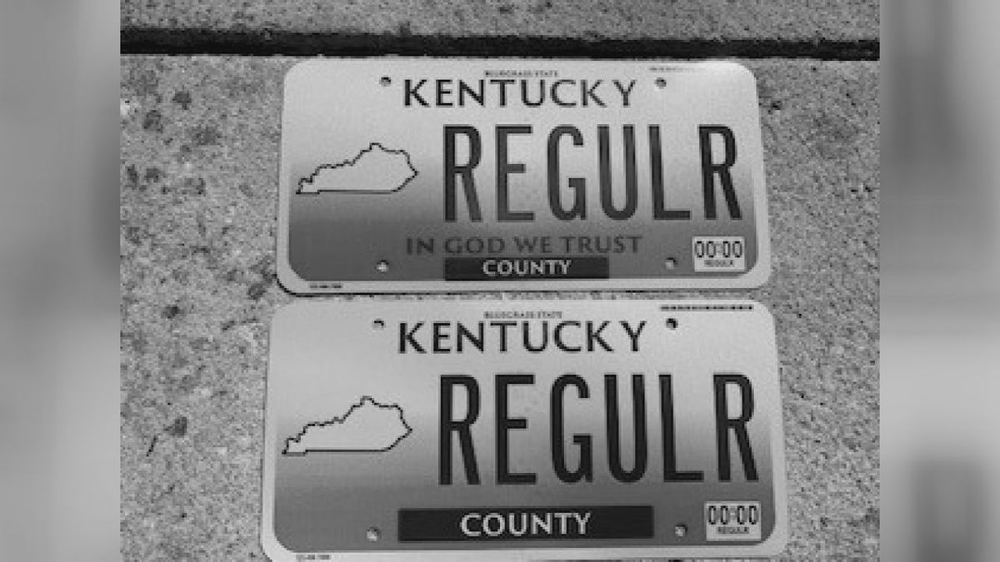

(675, 1200)


In [85]:
# import cv2 module for reading and displaying images from colab drive
from google.colab.patches import cv2, cv2_imshow

parts_image = cv2.imread("/content/drive/MyDrive/Colab Notebooks/Feature Extraction/LicensePlate_(test_image).jpg")
# cv2 module automatically detects a red, blue and green image channel so we
# need to convert the image to a single grayscale channel:
parts_image = cv2.cvtColor(parts_image, cv2.COLOR_BGR2GRAY)
cv2_imshow(parts_image)
print(parts_image.shape)

In [86]:
import numpy as np
# normalize image intensities

# implementation of im2double from Matlab
def im2double(img):
    info = np.iinfo(img.dtype) # Get the data type of the input image
    return img.astype(np.float) / info.max # Divide all values by the largest possible value in the datatype

normalized_parts_image = im2double(parts_image)
parts_image = normalized_parts_image * 255 # Levels, L = 2^n - 1 = 2^8 - 1 = 256 - 1 = 255

In [87]:
Length, Width = parts_image.shape
column_total = Length*Width # 499*609 = 303,891 pixels

# want a 1 dimensional vector to plot the histogram
# easiest with a 1 dimensional numpy column vector
parts_image_vector = parts_image.reshape(column_total, 1)
parts_image_vector = np.array(parts_image_vector)
print(parts_image_vector)
print(parts_image_vector.shape)

[[142.]
 [142.]
 [142.]
 ...
 [145.]
 [146.]
 [146.]]
(810000, 1)


Text(0.5, 1.0, 'Parts Image Histogram')

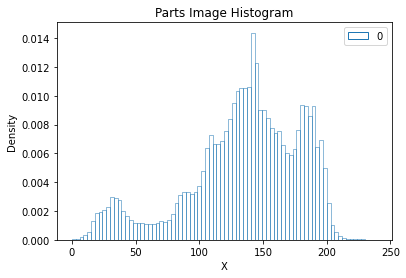

In [88]:
import seaborn as sns
import matplotlib.pyplot as plt

n_bins = 80
sns.histplot(parts_image_vector, stat = "density", bins = n_bins, kde = False, fill = False)
plt.xlabel('X')
plt.ylabel('Density')
plt.title(f"Parts Image Histogram")

Part 1: 
1.	Use the MATLAB function “edge” to find the edges of any image with different methods (Sobel, Canny, etc.).  


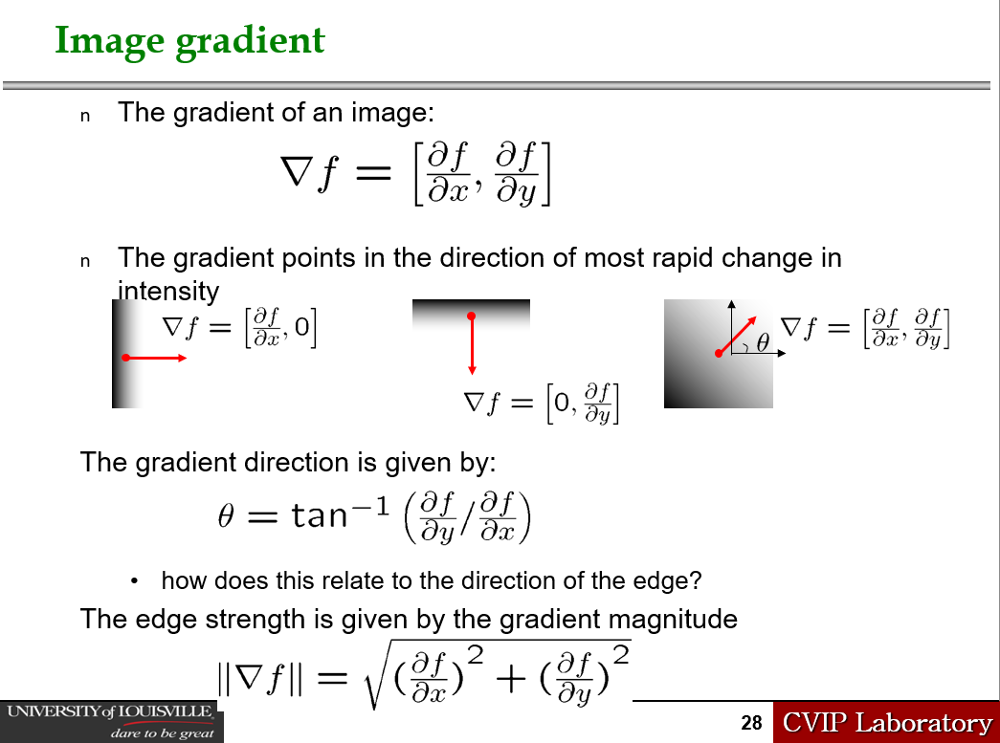

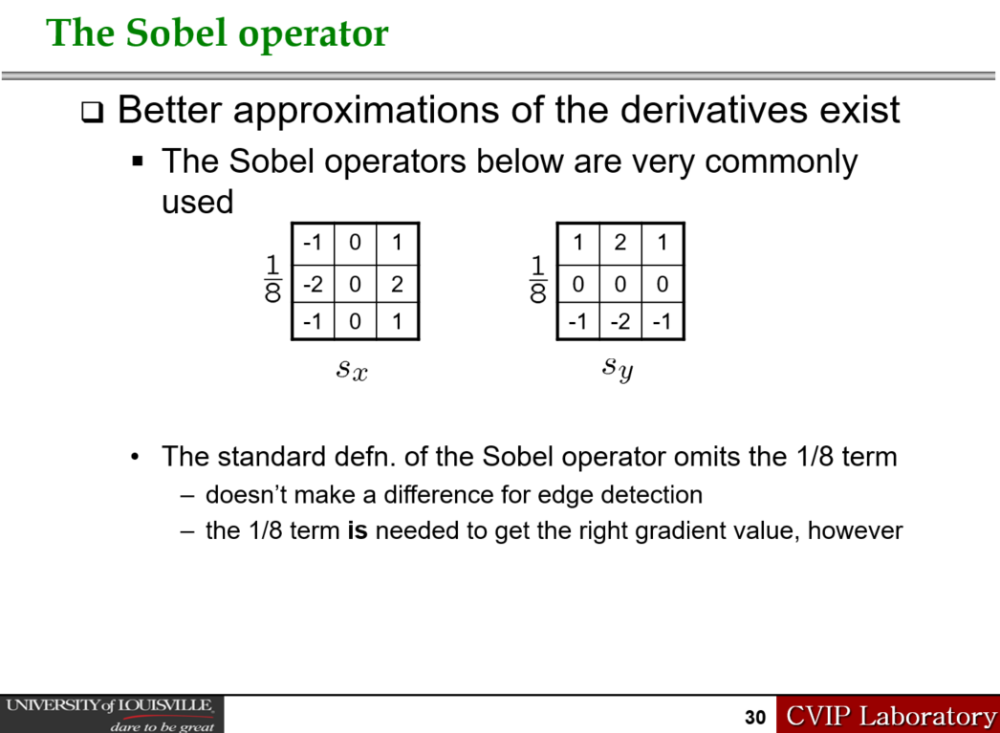

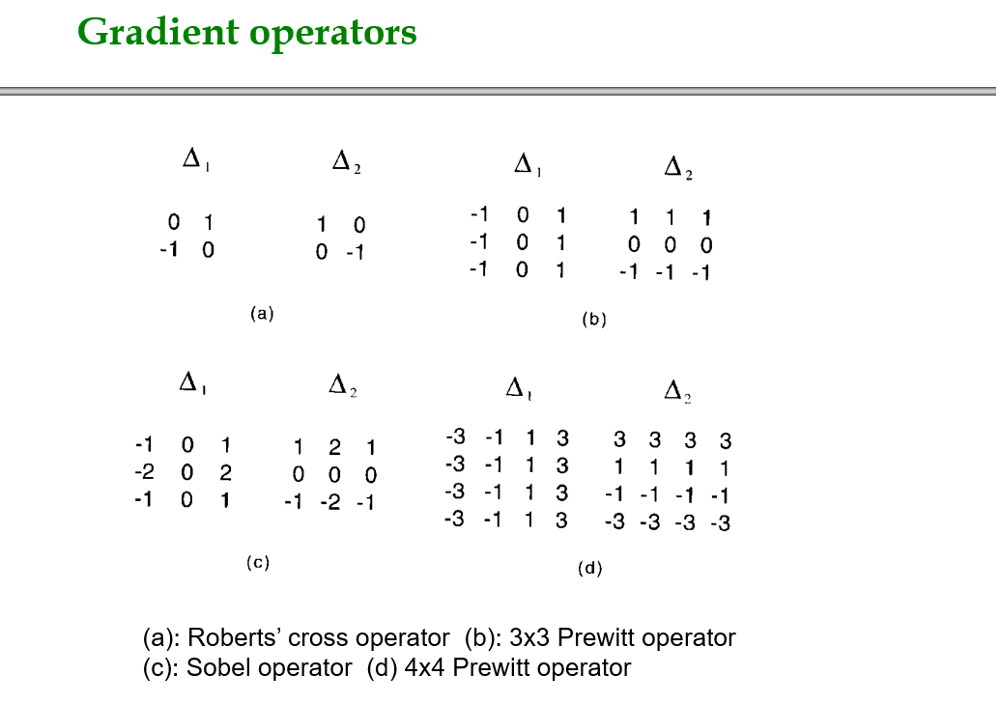

In [7]:
# (a) Roberts' Cross Operator
from scipy import ndimage

# Finds edges at those points where the gradient of I is maximum, using the Roberts approximation to the derivative.
def Roberts_filter(image):
  dx = np.array([[0, 1], [-1, 0]], np.float32)
  dy = dx.T

  Ix = ndimage.filters.convolve(image, dx)
  Iy = ndimage.filters.convolve(image, dy)

  # Here we can use the manhattan (absolute-value) norm or the euclidean norm to
  # measure distance of the gradient in the x and y direction
  image_gradient = np.hypot(Ix, Iy)
  image_gradient = image_gradient / image_gradient.max() * 255
  image_orientation = np.arctan2(Iy, Ix)

  return image_gradient, image_orientation

Original: 



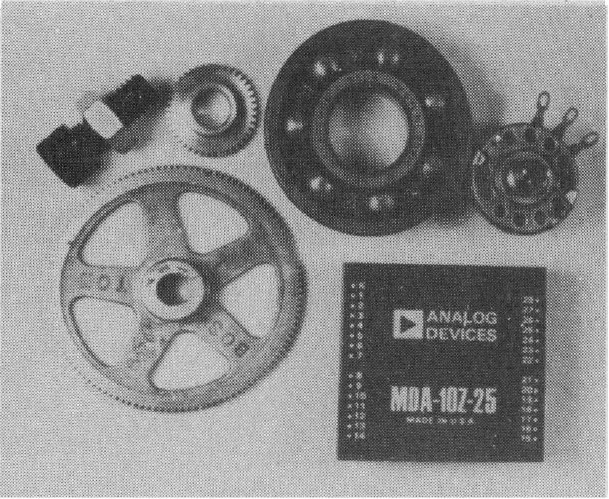

(499, 609)

Roberts' Gradient Intensity: 



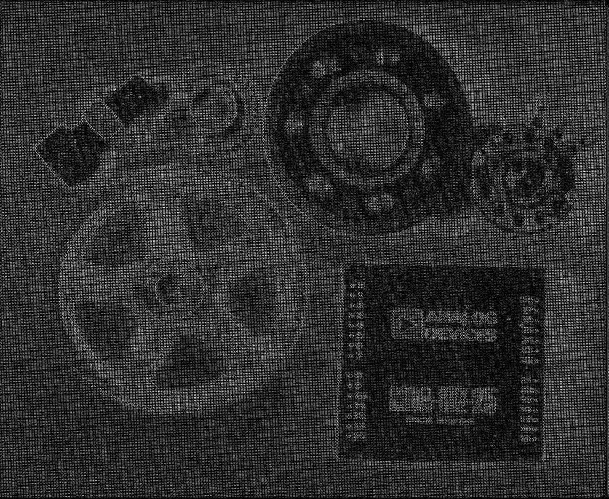

(499, 609)


In [10]:
Roberts_gradient_parts_image, Roberts_orientation_parts_image = Roberts_filter(parts_image_vector)
Roberts_gradient_parts_image = Roberts_gradient_parts_image.reshape(Length, Width)
Roberts_orientation_parts_image = Roberts_orientation_parts_image.reshape(Length, Width)

print("Original: \n")
cv2_imshow(parts_image)
print(parts_image.shape)

print("\nRoberts' Gradient Intensity: \n")
cv2_imshow(Roberts_gradient_parts_image)
print(Roberts_gradient_parts_image.shape)

In [11]:
# (b) 3x3 Prewitt Operator
from scipy import ndimage

# Finds edges at those points where the gradient of I is maximum, using the Prewitt approximation to the derivative.
def Prewitt_filter(image):
  dx = np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]], np.float32)
  dy = dx.T
  
  Ix = ndimage.filters.convolve(image, dx)
  Iy = ndimage.filters.convolve(image, dy)
  
  # Here we can use the manhattan (absolute-value) norm or the euclidean norm to
  # measure distance of the gradient in the x and y direction
  image_gradient = np.hypot(Ix, Iy)
  image_gradient = image_gradient / image_gradient.max() * 255
  image_orientation = np.arctan2(Iy, Ix)

  return image_gradient, image_orientation

Original: 



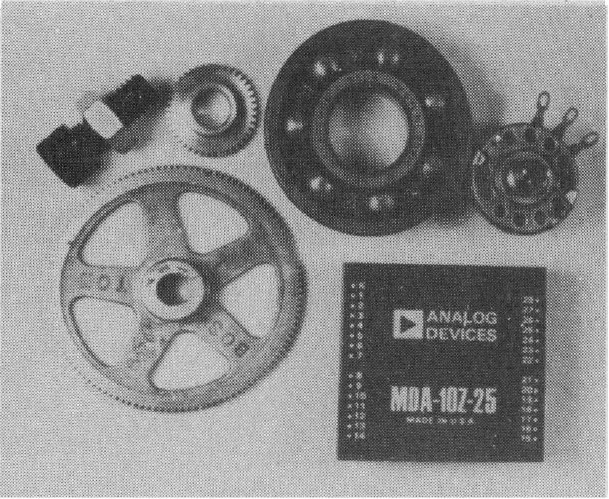

(499, 609)

3x3 Prewitt Gradient Intensity: 



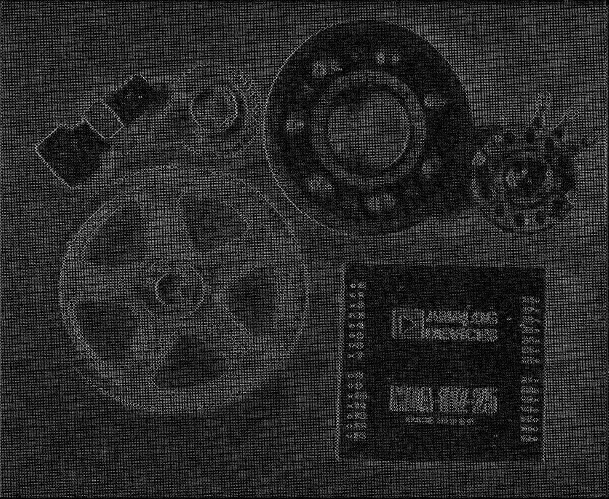

(499, 609)


In [12]:
Prewitt_gradient_parts_image, Prewitt_theta_parts_image = Prewitt_filter(parts_image_vector)
Prewitt_gradient_parts_image = Prewitt_gradient_parts_image.reshape(Length, Width)

print("Original: \n")
cv2_imshow(parts_image)
print(parts_image.shape)

print("\n3x3 Prewitt Gradient Intensity: \n")
cv2_imshow(Prewitt_gradient_parts_image)
print(Prewitt_gradient_parts_image.shape)

In [27]:
# (c) Sobel Operator
from scipy import ndimage

# Finds edges at those points where the gradient of the image I is maximum, using the Sobel approximation to the derivative.
def sobel_filter(image):
  dx = 1/8 * np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
  dy = 1/8 * np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32).T
  
  Ix = ndimage.filters.convolve(image, dx)
  Iy = ndimage.filters.convolve(image, dy)

  # Here we can use the manhattan (absolute-value) norm or the euclidean norm to
  # measure distance of the gradient in the x and y direction
  image_gradient = np.hypot(Ix, Iy)
  image_gradient = image_gradient / image_gradient.max() * 255
  image_orientation = np.arctan2(Iy, Ix)

  return image_gradient, image_orientation

Original: 



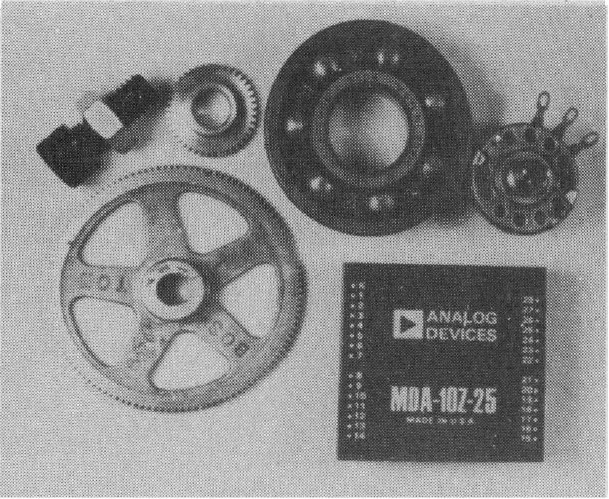

(499, 609)

Sobel Gradient Intensity: 



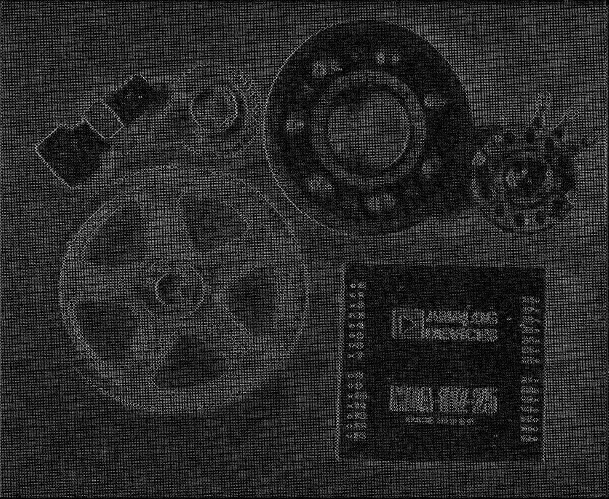

(499, 609)


In [28]:
sobel_gradient_parts_image_no_blurring, sobel_theta_parts_image = sobel_filter(parts_image_vector)
sobel_gradient_parts_image_no_blurring_reshape = sobel_gradient_parts_image_no_blurring.reshape(Length, Width)

print("Original: \n")
cv2_imshow(parts_image)
print(parts_image.shape)

print("\nSobel Gradient Intensity: \n")
cv2_imshow(sobel_gradient_parts_image_no_blurring_reshape)
print(sobel_gradient_parts_image_no_blurring_reshape.shape)

In [15]:
# (d) 4x4 Prewitt Operator
from scipy import ndimage

# Finds edges at those points where the gradient of I is maximum, using the Prewitt approximation to the derivative.
def Prewitt_filter(image):
  dx = np.array([[-3, -1, 1, 3], [-3, -1, 1, 3], [-3, -1, 1, 3], [-3, -1, 1, 3]], np.float32)
  dy = dx.T
  
  Ix = ndimage.filters.convolve(image, dx)
  Iy = ndimage.filters.convolve(image, dy)
  
  # CONVERTING IMAGE TO POLAR
  
  # Here we can use the manhattan (absolute-value) norm or the euclidean norm to
  # measure distance of the gradient in the x and y direction
  image_gradient = np.hypot(Ix, Iy)
  image_gradient = image_gradient / image_gradient.max() * 255
  image_orientation = np.arctan2(Iy, Ix)

  return image_gradient, image_orientation

Original: 



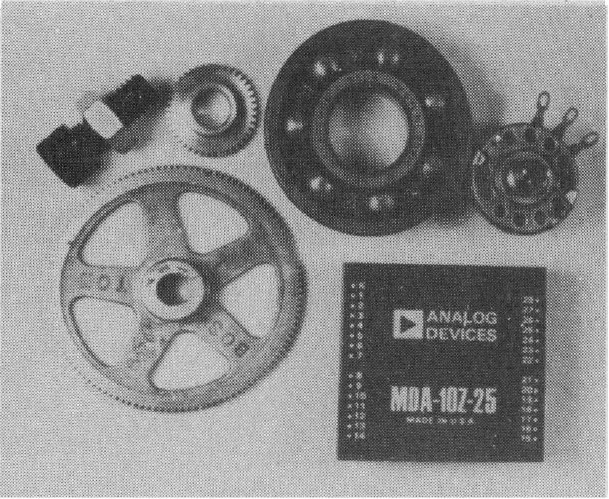

(499, 609)

4x4 Prewitt Gradient Intensity: 



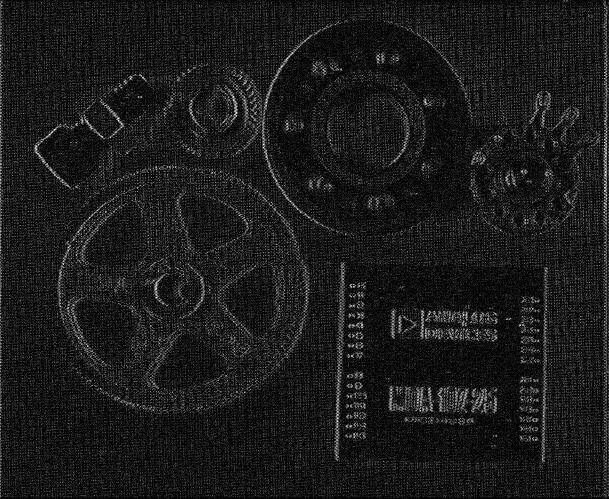

(499, 609)


In [16]:
Prewitt_gradient_parts_image, Prewitt_theta_parts_image = Prewitt_filter(parts_image_vector)
Prewitt_gradient_parts_image = Prewitt_gradient_parts_image.reshape(Length, Width)

print("Original: \n")
cv2_imshow(parts_image)
print(parts_image.shape)

print("\n4x4 Prewitt Gradient Intensity: \n")
cv2_imshow(Prewitt_gradient_parts_image)
print(Prewitt_gradient_parts_image.shape)

Currently we have been dealing with a lot of noise in the image and so the edges do not present themselves very well. Our solution is to smooth the image first.

i.e. Noise Reduction via the laplacian of a gaussian. AKA smoothing or gaussian blurring the image so that the local maxima will present the edges more clearly to the canny edge detection algorithm.

In [72]:
import numpy as np

def gaussian_kernel(size, sigma=1):
    size = int(size) // 2
    x, y = np.mgrid[-size:size+1, -size:size+1]
    normal = 1 / (2.0 * np.pi * sigma**2)
    g =  np.exp(-((x**2 + y**2) / (2.0*sigma**2))) * normal
    return g

In [89]:
def convolve2D(image, kernel, padding, strides=1):
    # Cross Correlation
    kernel = np.flipud(np.fliplr(kernel))

    # Gather Shapes of Kernel + Image + Padding
    xKernShape = kernel.shape[0]
    yKernShape = kernel.shape[1]
    xImgShape = image.shape[0]
    yImgShape = image.shape[1]

    # Shape of Output Convolution
    xOutput = int(((xImgShape - xKernShape + 2 * padding) / strides) + 1)
    yOutput = int(((yImgShape - yKernShape + 2 * padding) / strides) + 1)
    output = np.zeros((xOutput, yOutput))

    # Apply Equal Padding to All Sides
    if padding != 0:
        imagePadded = np.zeros((image.shape[0] + padding*2, image.shape[1] + padding*2))
        imagePadded[int(padding):int(-1 * padding), int(padding):int(-1 * padding)] = image
    else:
        imagePadded = image

    # Iterate through image
    for y in range(image.shape[1]):
        # Exit Convolution
        if y > image.shape[1] - yKernShape:
            break
        # Only Convolve if y has gone down by the specified Strides
        if y % strides == 0:
            for x in range(image.shape[0]):
                # Go to next row once kernel is out of bounds
                if x > image.shape[0] - xKernShape:
                    break
                try:
                    # Only Convolve if x has moved by the specified Strides
                    if x % strides == 0:
                        output[x, y] = (kernel * imagePadded[x: x + xKernShape, y: y + yKernShape]).sum()
                except:
                    break

    return output

In [90]:
size, standard_deviation = 5, 1.4
kernel = gaussian_kernel(size, standard_deviation)
image = parts_image
padding = 2 # image padding needs to be set to 2 to get the original image dimensions
blurred_image = convolve2D(image, kernel, padding)

Original: 



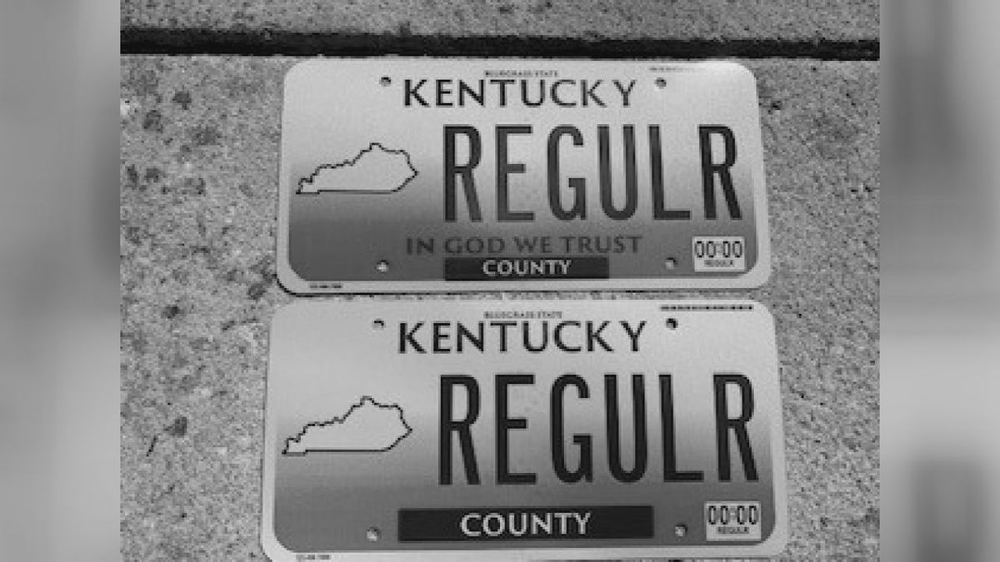

(675, 1200)


Text(0.5, 1.0, 'Image Histogram')

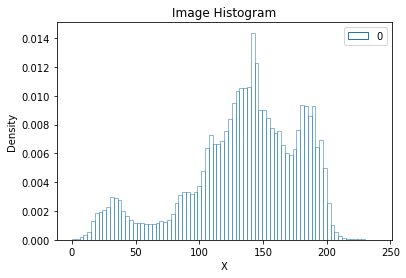

In [91]:
print("Original: \n")
cv2_imshow(image)
print(image.shape)

image_vector = image.reshape(column_total, 1)
n_bins = 80
sns.histplot(image_vector, stat = "density", bins = n_bins, kde = False, fill = False)
plt.xlabel('X')
plt.ylabel('Density')
plt.title(f"Image Histogram")

Gaussian Blurred Image: 



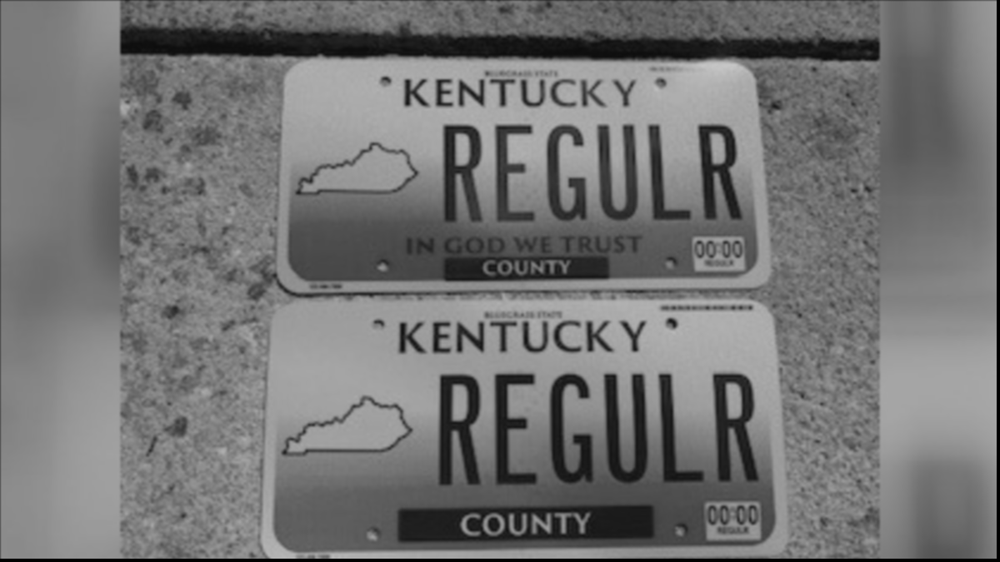

(675, 1200)


Text(0.5, 1.0, 'Image Histogram')

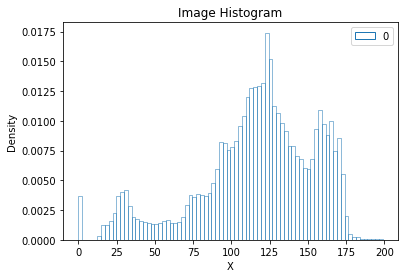

In [92]:
print("Gaussian Blurred Image: \n")
cv2_imshow(blurred_image)
print(blurred_image.shape)

Length, Width = blurred_image.shape
column_total = Length * Width

image_vector = blurred_image.reshape(column_total, 1)
n_bins = 80
sns.histplot(image_vector, stat = "density", bins = n_bins, kde = False, fill = False)
plt.xlabel('X')
plt.ylabel('Density')
plt.title(f"Image Histogram")

Show the magnitude spectra of Gaussian Blurring an image


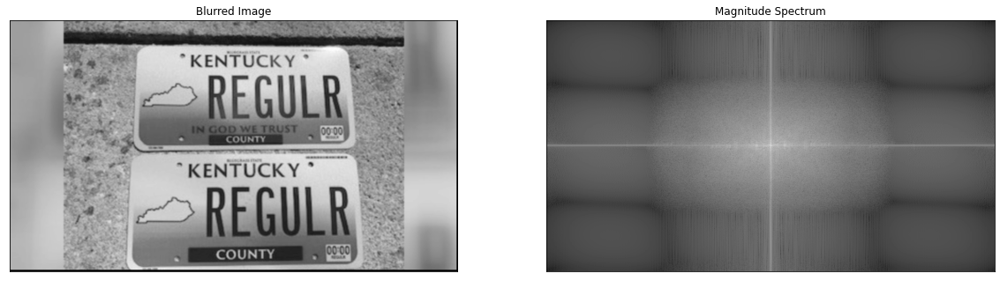

In [93]:
f = np.fft.fft2(blurred_image)
fshift = np.fft.fftshift(f)
magnitude_spectrum = 30*np.log(np.abs(fshift))

plt.figure(figsize=(20,10))
plt.subplot(121),plt.imshow(blurred_image, cmap = 'gray')
plt.title('Blurred Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'gray')
plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
plt.show()

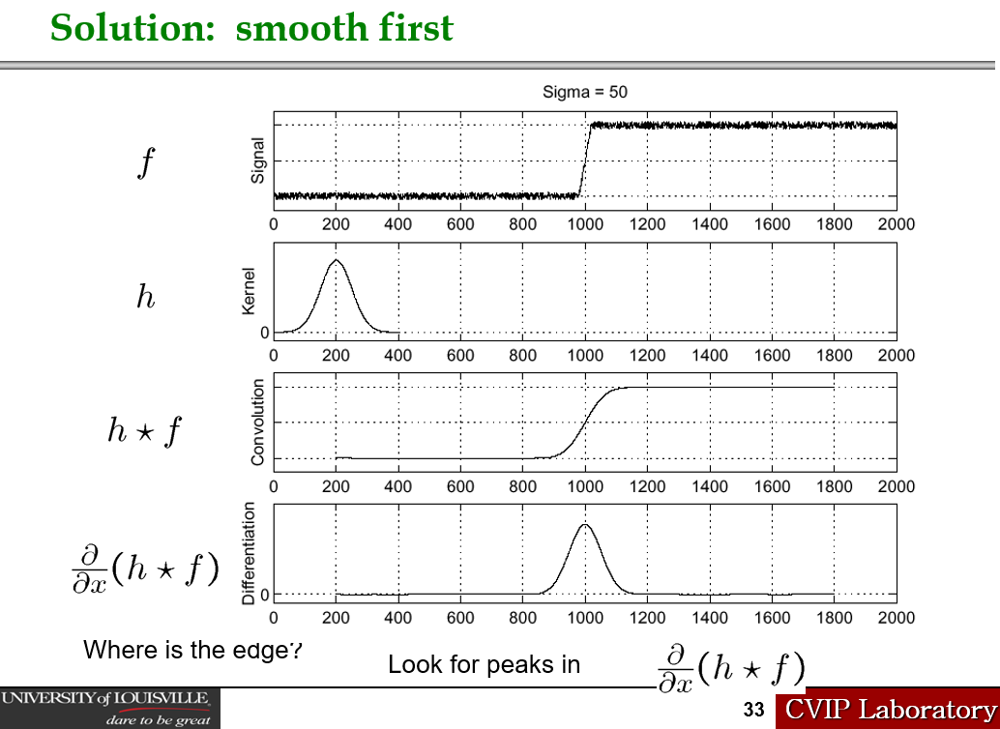

Gaussian kernels of different sizes can be made, more or less centered or flattened. Obviously, the larger the kernel is, the more the output image will be blurred.

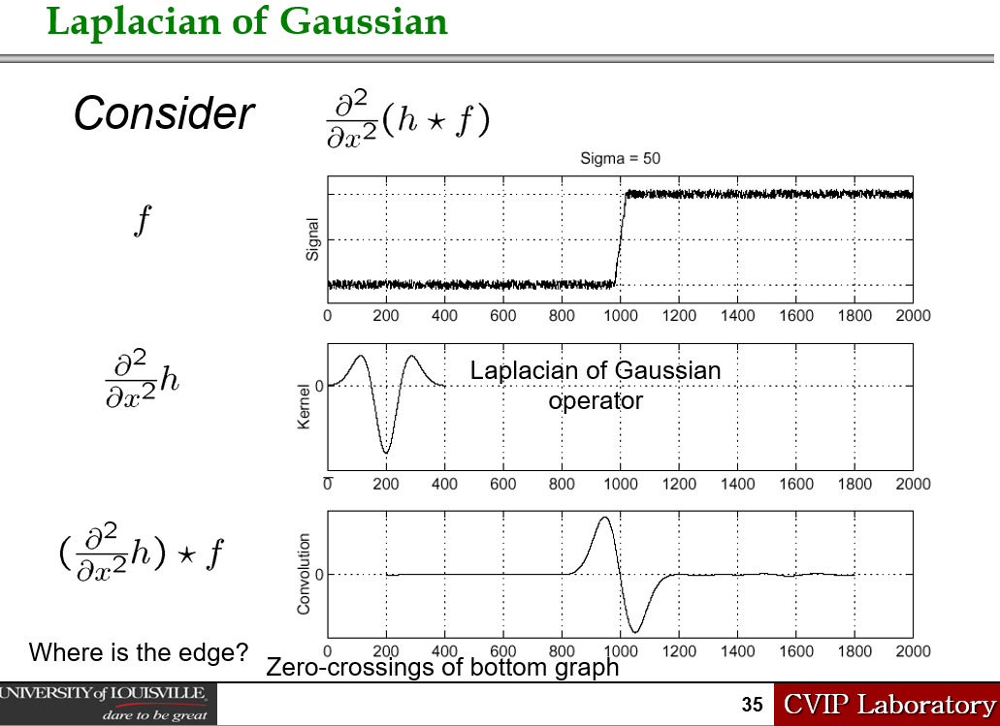

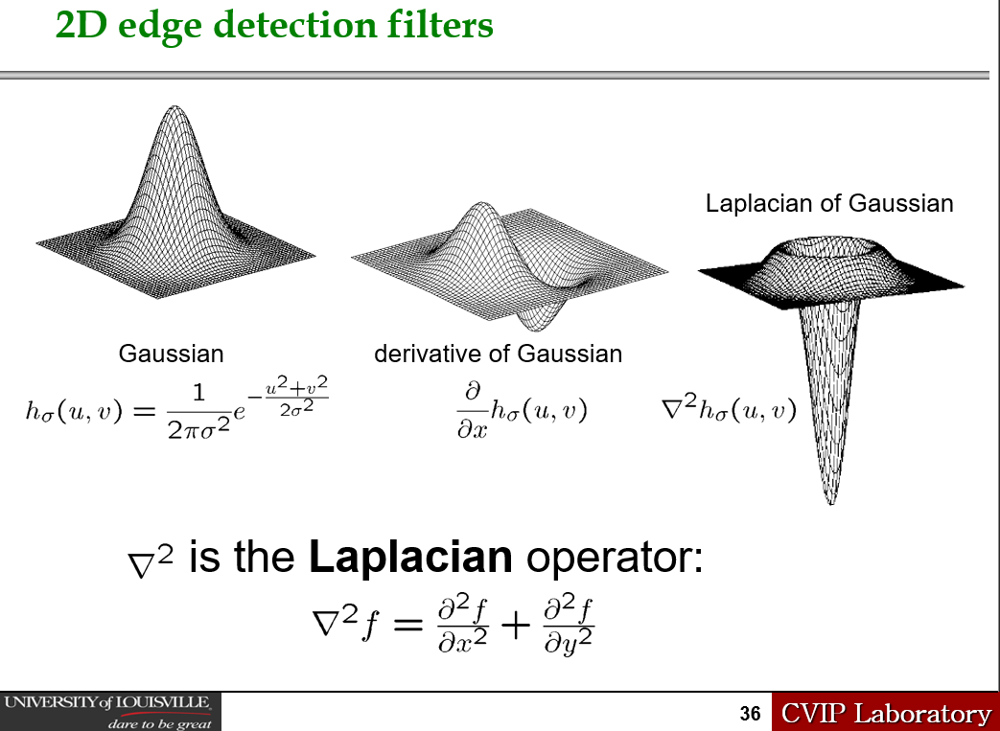

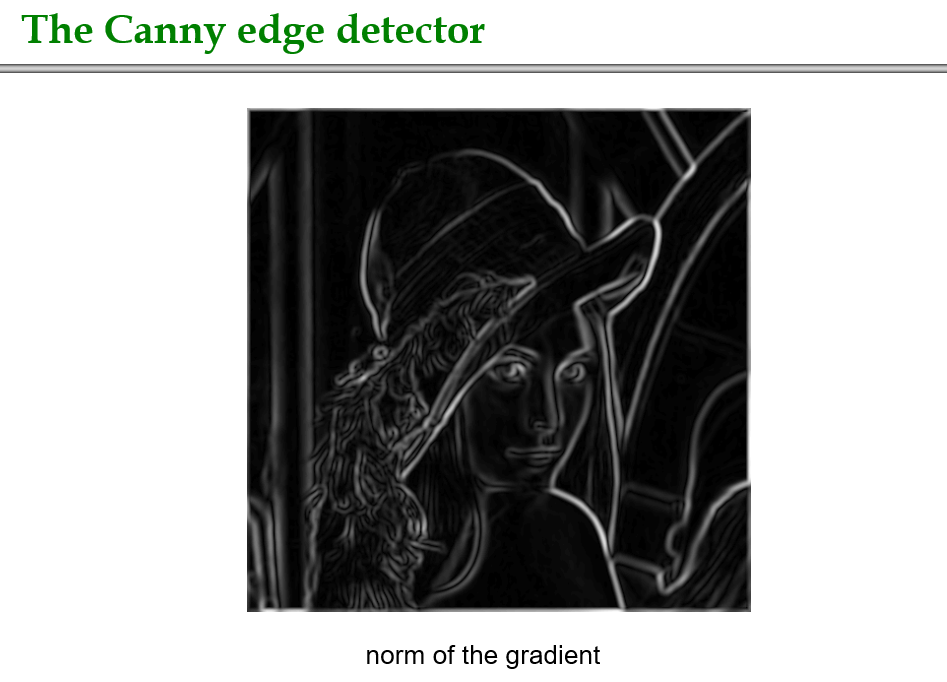

In [94]:
from scipy import ndimage

def sobel_filters(img):
    Kx = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], np.float32)
    Ky = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]], np.float32)
    
    Ix = ndimage.filters.convolve(img, Kx)
    Iy = ndimage.filters.convolve(img, Ky)
    
    G = np.hypot(Ix, Iy)
    G = G / G.max() * 255
    theta = np.arctan2(Iy, Ix)
    
    return G, theta

Laplacian of Gaussian on Image: 



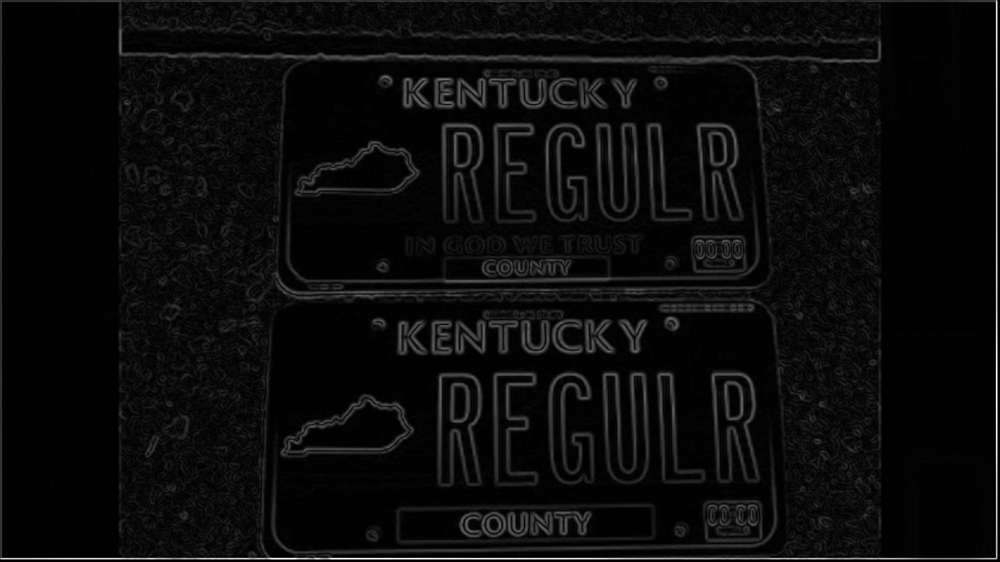

(675, 1200)


Text(0.5, 1.0, 'Image Histogram')

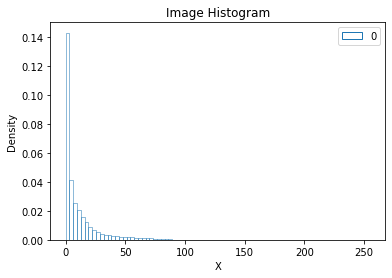

In [95]:
sobel_gradient_image, theta = sobel_filters(blurred_image)

print("Laplacian of Gaussian on Image: \n")
cv2_imshow(sobel_gradient_image)
print(sobel_gradient_image.shape)

image_vector = sobel_gradient_image.reshape(column_total, 1)
n_bins = 80
sns.histplot(image_vector, stat = "density", bins = n_bins, kde = False, fill = False)
plt.xlabel('X')
plt.ylabel('Density')
plt.title(f"Image Histogram")

The Gaussian blurring (laplacian of a gaussian) has vastly improved the edge definition when using the sobel edge detection implementation.

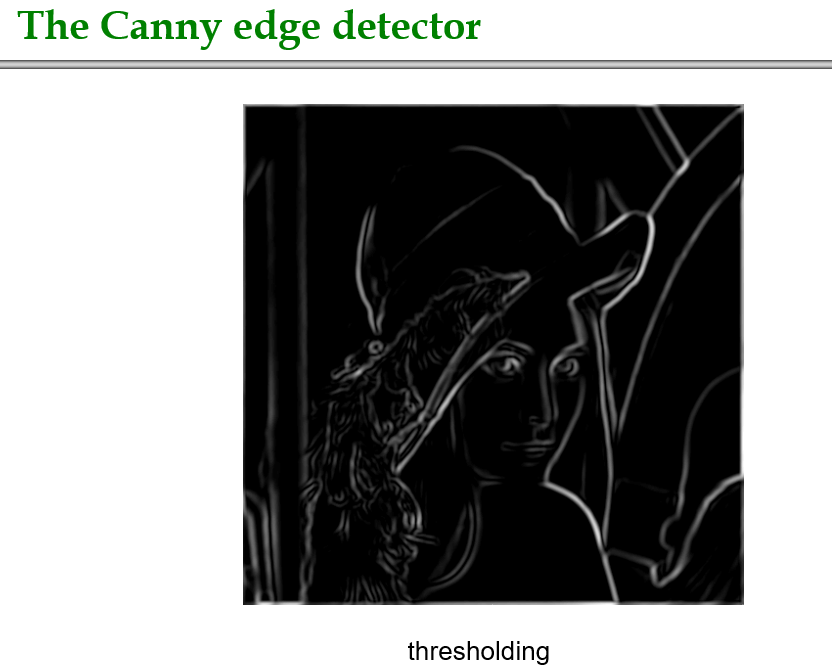

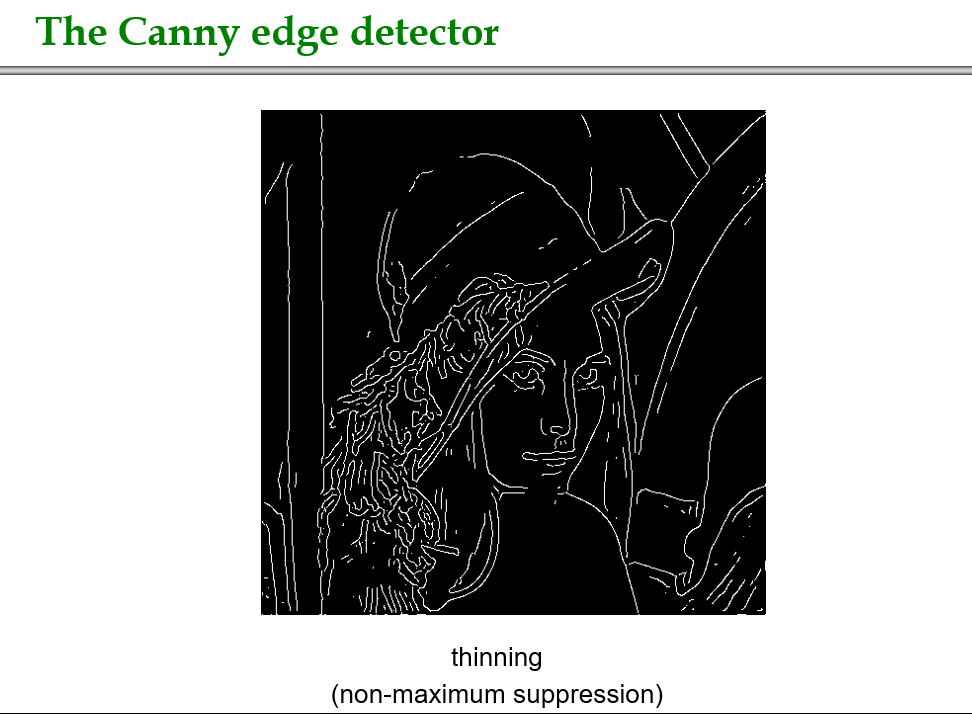

In [96]:
def non_max_suppression(img, D):
    M, N = img.shape
    Z = np.zeros((M,N), dtype=np.int32)
    angle = D * 180. / np.pi
    angle[angle < 0] += 180

    
    for i in range(1,M-1):
        for j in range(1,N-1):
            try:
                q = 255
                r = 255
                
               #angle 0
                if (0 <= angle[i,j] < 22.5) or (157.5 <= angle[i,j] <= 180):
                    q = img[i, j+1]
                    r = img[i, j-1]
                #angle 45
                elif (22.5 <= angle[i,j] < 67.5):
                    q = img[i+1, j-1]
                    r = img[i-1, j+1]
                #angle 90
                elif (67.5 <= angle[i,j] < 112.5):
                    q = img[i+1, j]
                    r = img[i-1, j]
                #angle 135
                elif (112.5 <= angle[i,j] < 157.5):
                    q = img[i-1, j-1]
                    r = img[i+1, j+1]

                if (img[i,j] >= q) and (img[i,j] >= r):
                    Z[i,j] = img[i,j]
                else:
                    Z[i,j] = 0

            except IndexError as e:
                pass
    
    return Z

non-max Supressed (thinning) Image: 



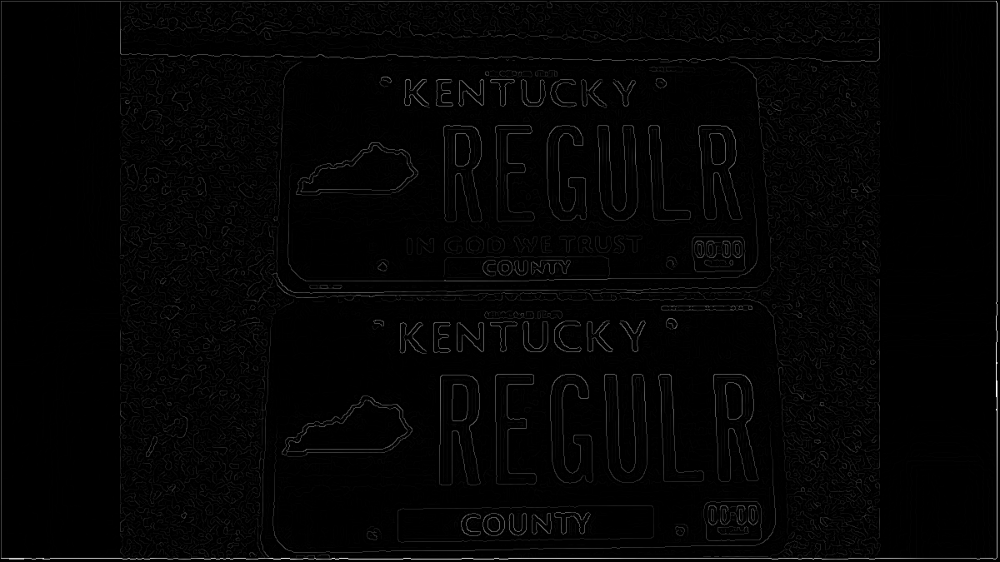

(675, 1200)


Text(0.5, 1.0, 'Image Histogram')

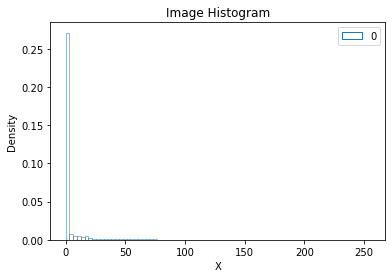

In [97]:
non_max_supressed_image = non_max_suppression(sobel_gradient_image, theta)

print("non-max Supressed (thinning) Image: \n")
cv2_imshow(non_max_supressed_image)
print(non_max_supressed_image.shape)

image_vector = non_max_supressed_image.reshape(column_total, 1)
n_bins = 80
sns.histplot(image_vector, stat = "density", bins = n_bins, kde = False, fill = False)
plt.xlabel('X')
plt.ylabel('Density')
plt.title(f"Image Histogram")

In [98]:
def threshold(img, lowThresholdRatio=0.05, highThresholdRatio=0.09):
    
    highThreshold = img.max() * highThresholdRatio;
    lowThreshold = highThreshold * lowThresholdRatio;
    
    M, N = img.shape
    res = np.zeros((M,N), dtype=np.int32)
    
    weak = np.int32(25)
    strong = np.int32(255)
    
    strong_i, strong_j = np.where(img >= highThreshold)
    zeros_i, zeros_j = np.where(img < lowThreshold)
    
    weak_i, weak_j = np.where((img <= highThreshold) & (img >= lowThreshold))
    
    res[strong_i, strong_j] = strong
    res[weak_i, weak_j] = weak
    
    return (res, weak, strong)

Double Thresholded Image: 



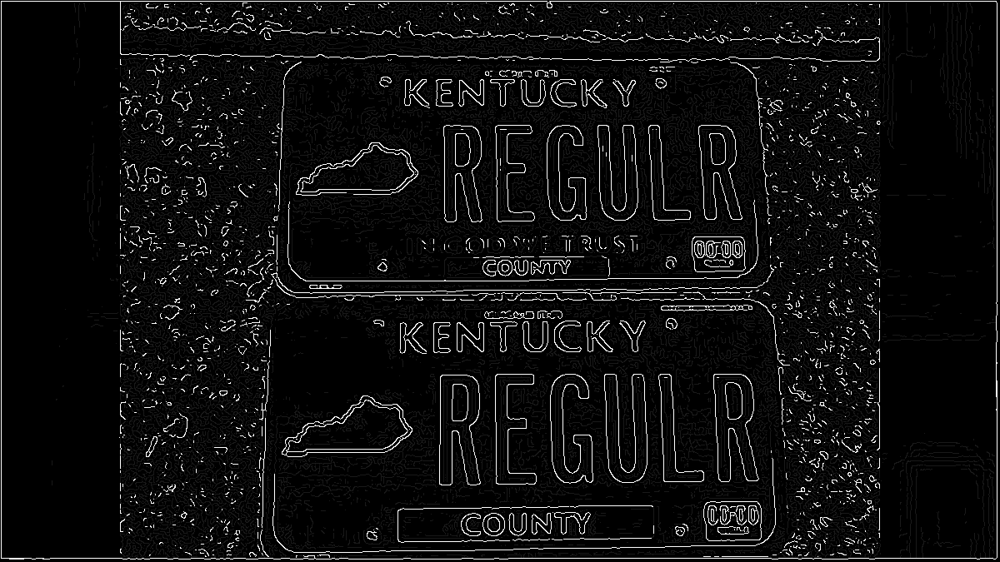

(675, 1200)


Text(0.5, 1.0, 'Image Histogram')

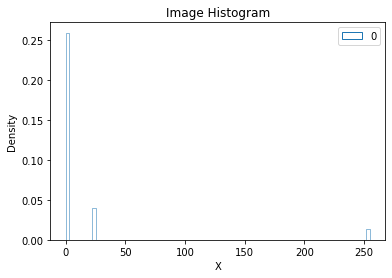

In [99]:
double_threshold_image, weak, strong = threshold(non_max_supressed_image)

print("Double Thresholded Image: \n")
cv2_imshow(double_threshold_image)
print(double_threshold_image.shape)

image_vector = double_threshold_image.reshape(column_total, 1)
n_bins = 80
sns.histplot(image_vector, stat = "density", bins = n_bins, kde = False, fill = False)
plt.xlabel('X')
plt.ylabel('Density')
plt.title(f"Image Histogram")

In [100]:
def hysteresis(img, weak, strong=255):
    M, N = img.shape  
    for i in range(1, M-1):
        for j in range(1, N-1):
            if (img[i,j] == weak):
                try:
                    if ((img[i+1, j-1] == strong) or (img[i+1, j] == strong) or (img[i+1, j+1] == strong)
                        or (img[i, j-1] == strong) or (img[i, j+1] == strong)
                        or (img[i-1, j-1] == strong) or (img[i-1, j] == strong) or (img[i-1, j+1] == strong)):
                        img[i, j] = strong
                    else:
                        img[i, j] = 0
                except IndexError as e:
                    pass
    return img

Canny Image: 



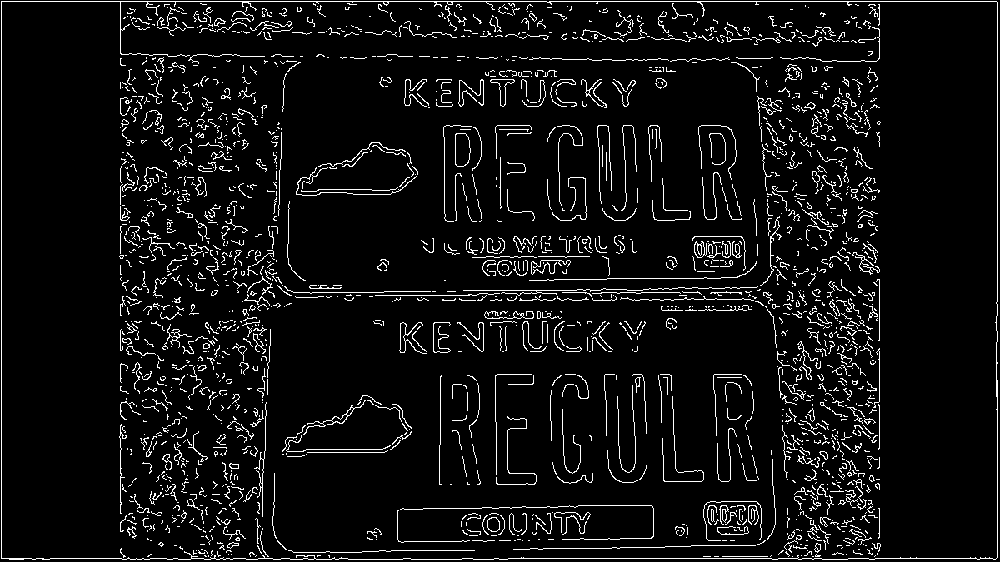

(675, 1200)


Text(0.5, 1.0, 'Image Histogram')

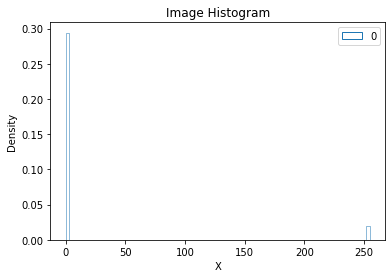

In [101]:
canny_image = hysteresis(double_threshold_image, weak)

print("Canny Image: \n")
cv2_imshow(canny_image)
print(canny_image.shape)

image_vector = canny_image.reshape(column_total, 1)
n_bins = 80
sns.histplot(image_vector, stat = "density", bins = n_bins, kde = False, fill = False)
plt.xlabel('X')
plt.ylabel('Density')
plt.title(f"Image Histogram")

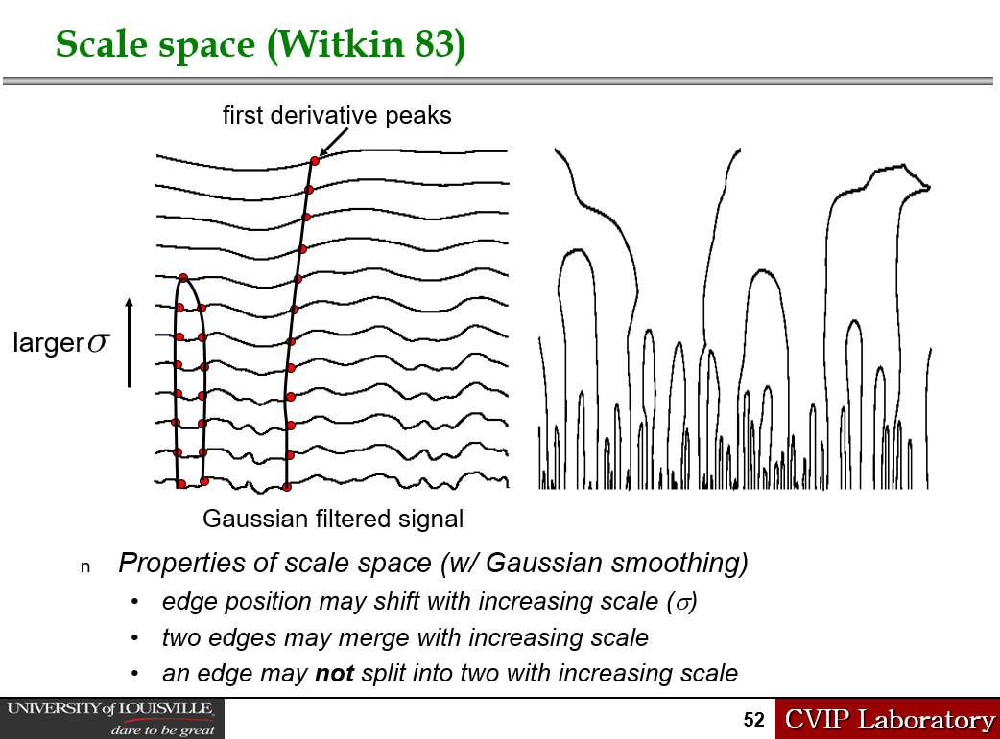

### 2.	The Harris corner detector finds corners in an image. Conceptually, corner detection can be thought of as an auto-correlation of an image patch. Consider a window which slides over an image patch. If the image patch is constant or ”flat”, then there will be little to no intensity changes in the window. If the image patch has an edge, then there will be no intensity changes in the window along the direction of the edge. If a corner is present, however, then there will be a strong intensity changes in the window regardless of the direction. Implement a Harris corner detector. A helping code is provided in Fig. 1, show the intermediate steps of the detection process. A complete code that can be used to get the corners is provided in Fig 2. You can call this function as:
    harris3(imag,2.5,10,10,1);


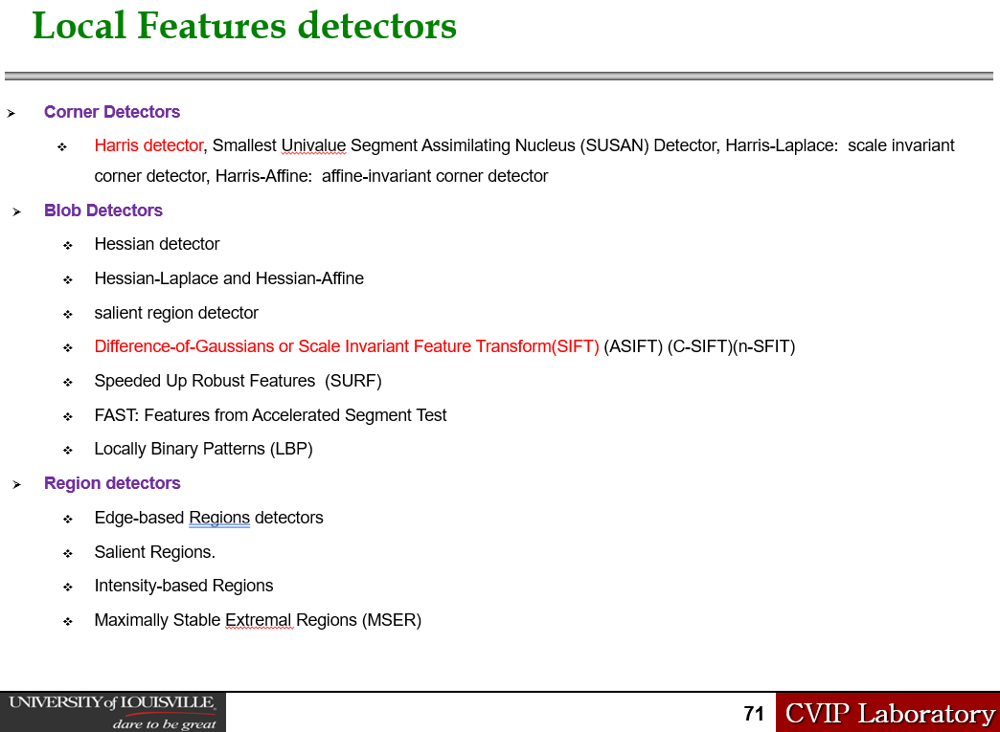

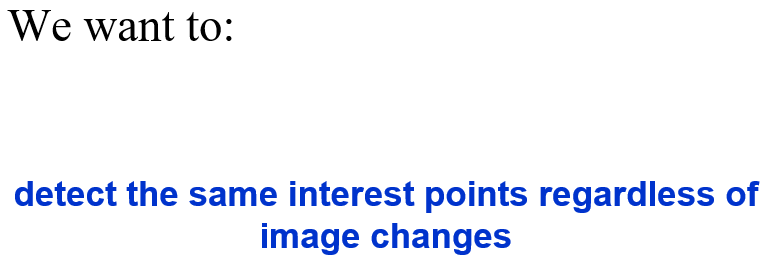

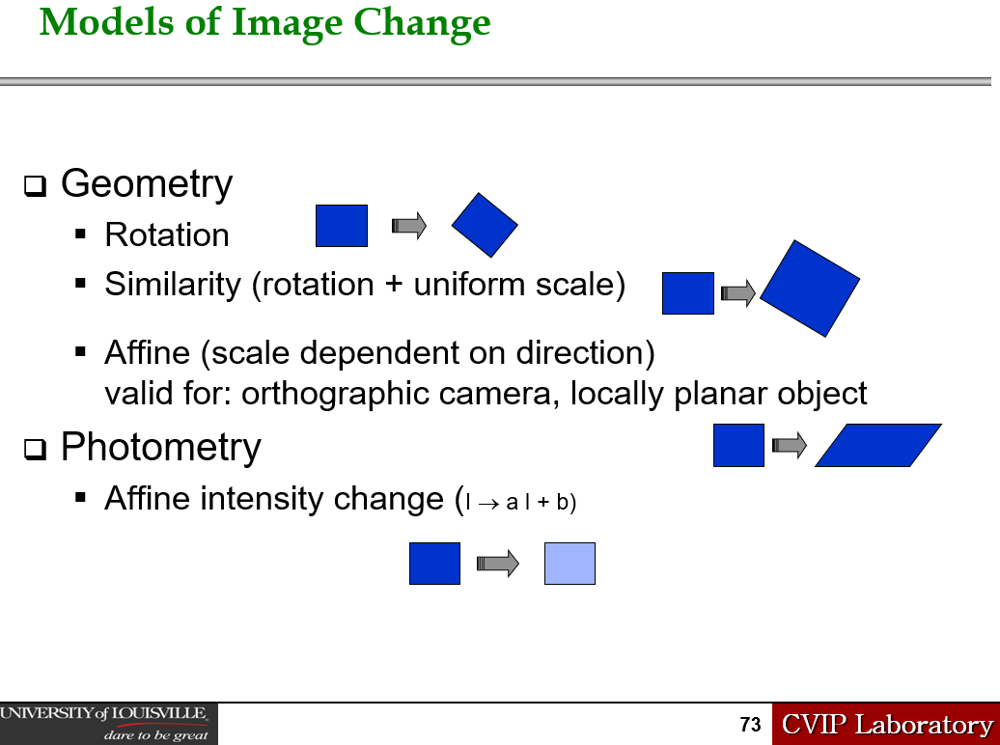

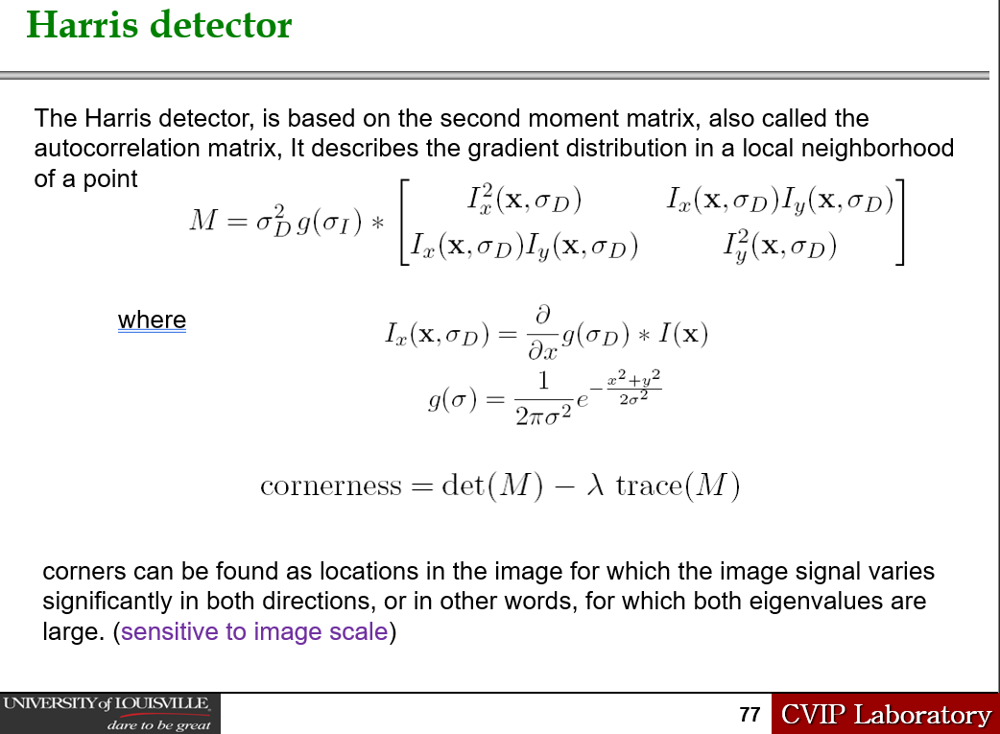

In [ ]:
# import cv2 module for reading and displaying images from colab drive
from google.colab.patches import cv2, cv2_imshow

3.	Apply your implementation of the Harris corner detector to the cubes images to find the corners as shown Fig. 3 bellow.

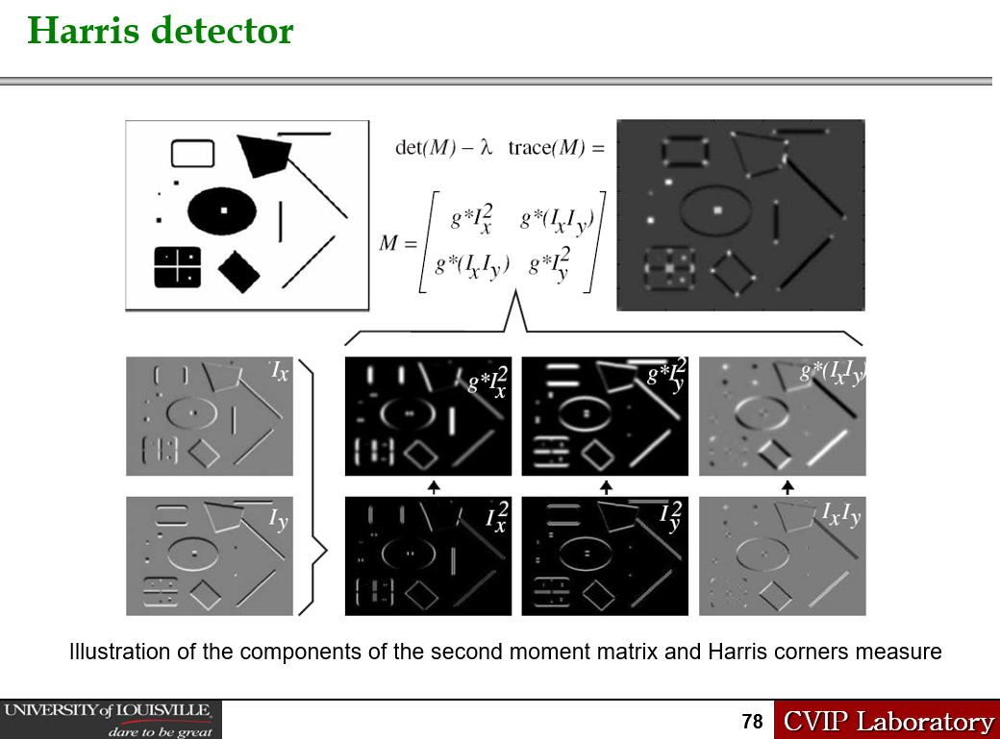

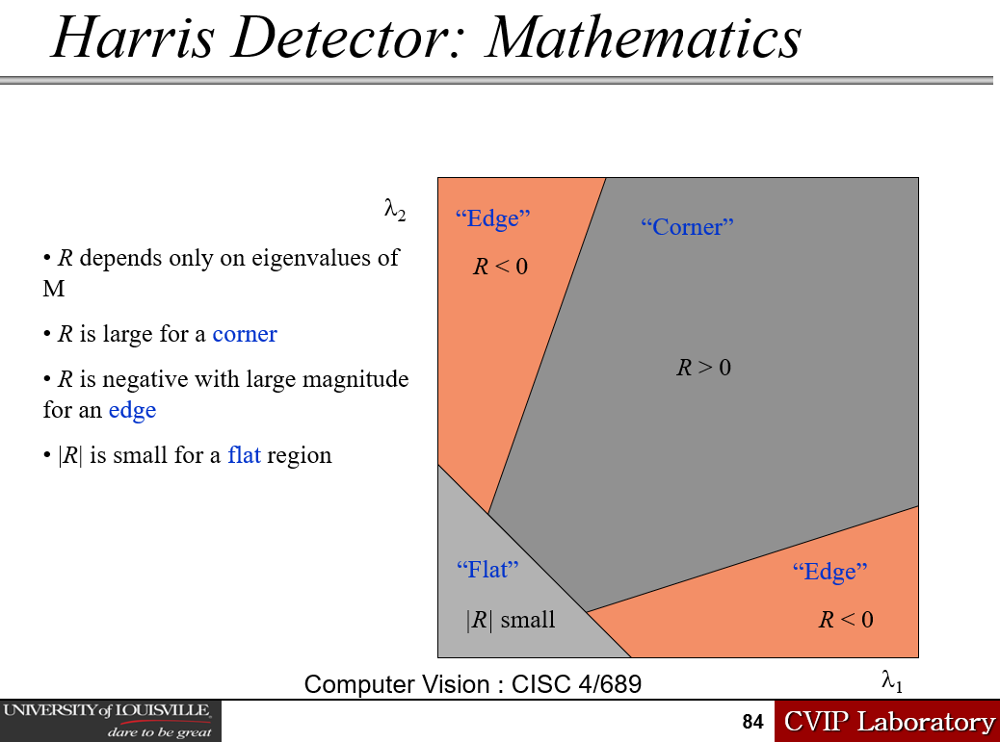

In [102]:
import numpy as np
import cv2
import glob

# Kernel operation using input operator of size 3*3
def GetSobel(image, Sobel, width, height):
  # Initialize the matrix
  I_d = np.zeros((width, height), np.float32)

  # For every pixel in the image
  for rows in range(width):
      for cols in range(height):
          # Run the Sobel kernel for each pixel
          if rows >= 1 or rows <= width-2 and cols >= 1 or cols <= height-2:
              for ind in range(3):
                  for ite in range(3):
                      I_d[rows][cols] += Sobel[ind][ite] * image[rows - ind - 1][cols - ite - 1]
          else:
              I_d[rows][cols] = image[rows][cols]

  return I_d

# Method implements the Harris Corner Detection algorithm
def HarrisCornerDetection(image, k, Sigma, size, threshold):

  # The two Sobel operators - for x and y direction
  SobelX = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
  SobelY = SobelX.T

  w, h = image.shape

  # X and Y derivative of image using Sobel operator
  Ix = GetSobel(image, SobelX, w, h)
  Iy = GetSobel(image, SobelY, w, h)

  for ind1 in range(w):
      for ind2 in range(h):
          if Iy[ind1][ind2] < 0:
              Iy[ind1][ind2] *= -1
          if Ix[ind1][ind2] < 0:
              Ix[ind1][ind2] *= -1
              

  # # Display the output results after Sobel operations
  # print("\nIx:\n")
  # cv2_imshow(Ix)
  # print("\nIy:\n")
  # cv2_imshow(Iy)

  # Compute components of harris second moments matrix M
  '''
  M = | Ixx Ixy |
      | Iyx Iyy |
  '''
  Ixx = np.square(Ix)
  Iyy = np.square(Iy)

  Ixy = np.multiply(Ix, Iy)
  Iyx = np.multiply(Iy, Ix)

  # # Display the output second moments matrix components
  # print("\nIxx:\n")
  # cv2_imshow(Ixx)
  # print("\nIyy:\n")
  # cv2_imshow(Iyy)
  # print("\nIxy:\n")
  # cv2_imshow(Ixy)
  # print("\nIyx:\n")
  # cv2_imshow(Iyx)

  # Use Gaussian Blurring
  kernelsize = (size, size)

  Ixx = cv2.GaussianBlur(Ixx, kernelsize, Sigma)
  Iyy = cv2.GaussianBlur(Iyy, kernelsize, Sigma)
  Ixy = cv2.GaussianBlur(Ixy, kernelsize, Sigma)
  Iyx = cv2.GaussianBlur(Iyx, kernelsize, Sigma)
  # print(Ixy.shape, Iyx.shape)

  R = np.zeros((w, h), np.float32)
  # For every pixel find the corner strength
  # i.e. compute the harris response R
  for row in range(w):
    for col in range(h):
      '''
      M = | Ixx Ixy |
          | Iyx Iyy |
      '''
      M = np.array([[Ixx[row][col], Ixy[row][col]], [Iyx[row][col], Iyy[row][col]]])
      '''
      R = detM - k(traceM)^2
      '''
      R[row][col] = np.linalg.det(M) - (k * np.square(np.trace(M)))

  # Plot detected corners on image
  radius = 1
  color = (255, 0, 0)  # Red
  thickness = 1
  CornerStrengthThreshold = threshold
  
  count = 0
  PointList = []
  # Look for Corner strengths above the threshold
  for row in range(w):
    for col in range(h):
      if R[row][col] > CornerStrengthThreshold:
        # print(R[row][col])
        max = R[row][col]

        # Local non-maxima suppression
        skip = False
        for nrow in range(5):
          for ncol in range(5):
            if row + nrow - 2 < w and col + ncol - 2 < h:
              if R[row + nrow - 2][col + ncol - 2] > max:
                skip = True
                break

        if not skip:
          # Point is expressed in x, y which is col, row
          count+=1
          cv2.circle(rgb_image_copy, (col, row), radius, color, thickness)
          PointList.append((row, col))
  return rgb_image_copy, count


Number of corner pixels detected: 57



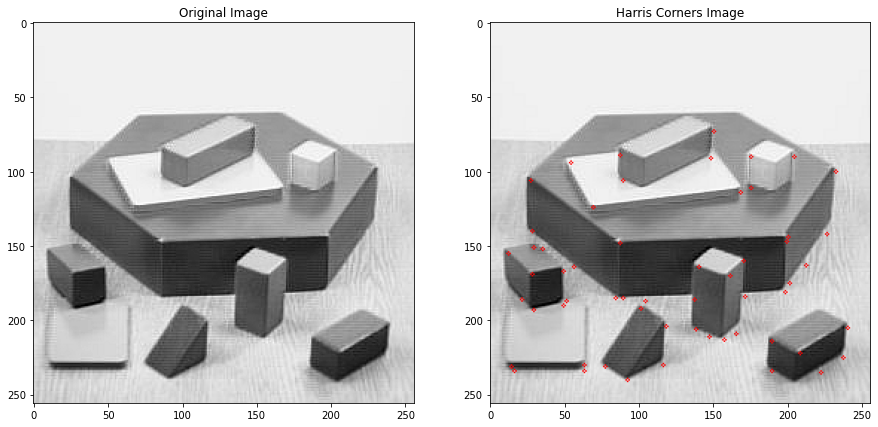

In [103]:
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Original Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners Image')
print(f"\nNumber of corner pixels detected: {count}\n")

The built in harris detector works a bit better. But the lst implementation seems the most precise. And a lot of the pixels are repainted by the built in function. 


4.	Generate a set of rotated and resized images (10 images) to test the performance of the Harris detector and then answer these questions. Is it scale invariant? Is it rotation invariant?

i.e. corner detection should be rotation, scale and translation invariant.

In [ ]:
def rotation(img,ang):
    rows = len(img) 
    cols = len(img[0])
    M = cv2.getRotationMatrix2D((cols/2,rows/2),ang,1)
    dst = cv2.warpAffine(img,M,(cols,rows))
    return dst

Number of corner pixels detected: 45


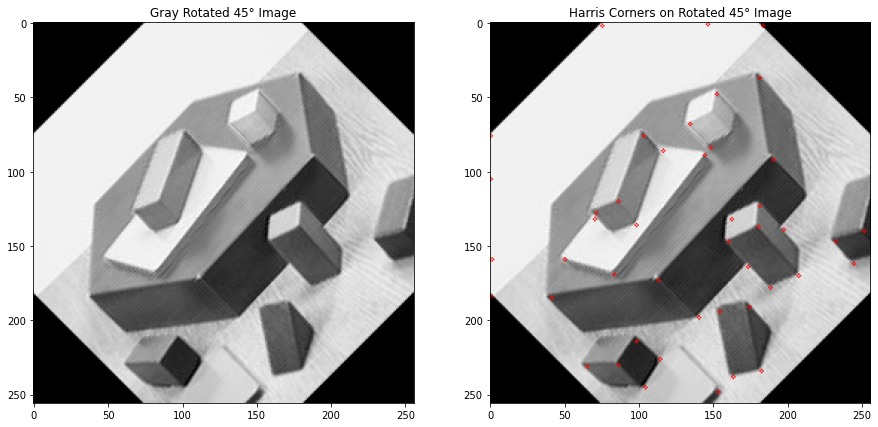

In [ ]:
# 45 Degree Rotation
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Rotate the image
gray_image = rotation(gray_image, 45)
rgb_image = rotation(rgb_image, 45)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray Rotated 45\u00B0 Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on Rotated 45\u00B0 Image')
print(f"Number of corner pixels detected: {count}")

Number of corner pixels detected: 57


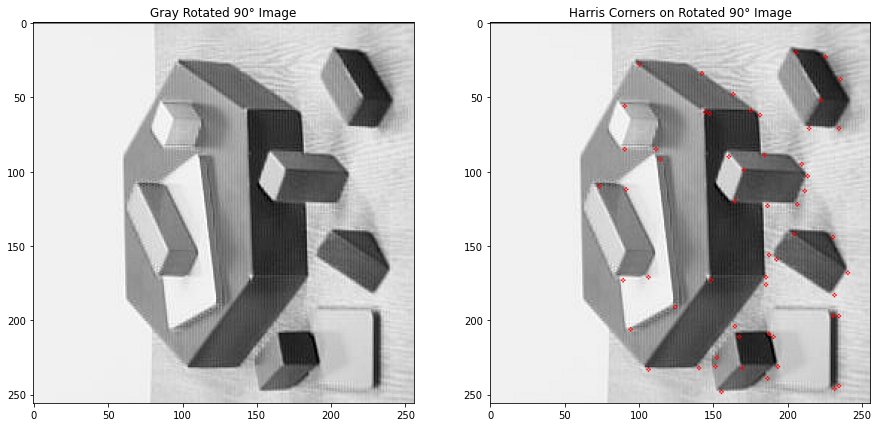

In [ ]:
# 90 Degree Rotation
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Rotate the image
gray_image = rotation(gray_image, 90)
rgb_image = rotation(rgb_image, 90)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray Rotated 90\u00B0 Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on Rotated 90\u00B0 Image')
print(f"Number of corner pixels detected: {count}")

Number of corner pixels detected: 44


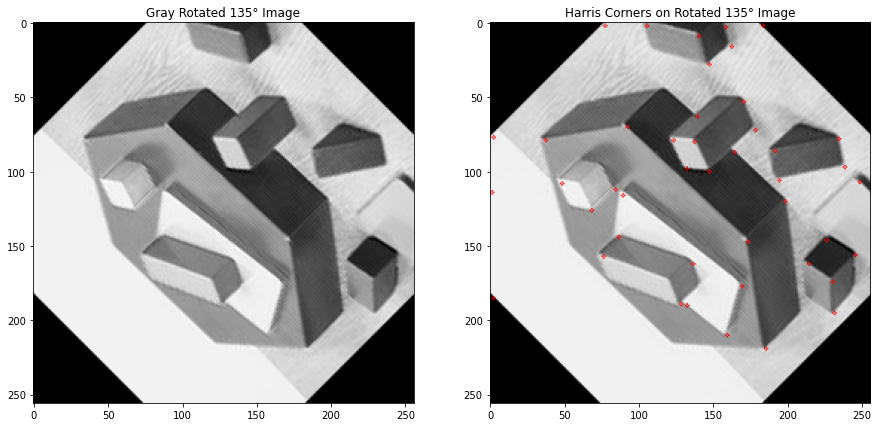

In [ ]:
# 135 Degree Rotation
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Rotate the image
gray_image = rotation(gray_image, 135)
rgb_image = rotation(rgb_image, 135)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray Rotated 135\u00B0 Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on Rotated 135\u00B0 Image')
print(f"Number of corner pixels detected: {count}")

Number of corner pixels detected: 61


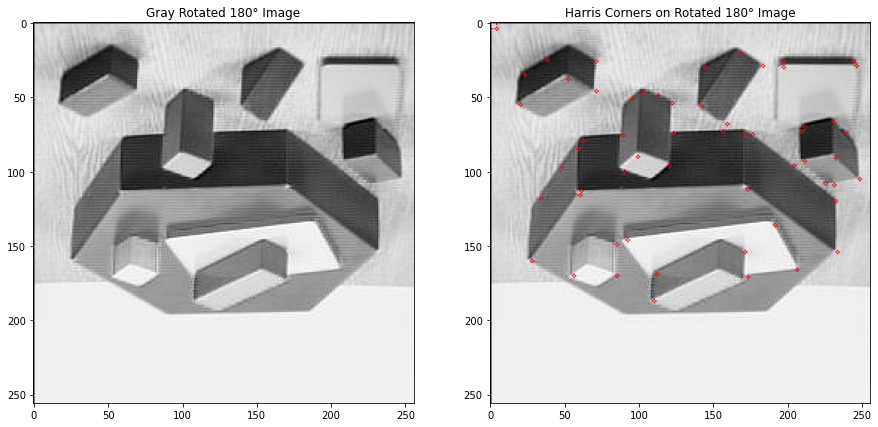

In [ ]:
# 180 Degree Rotation
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Rotate the image
gray_image = rotation(gray_image, 180)
rgb_image = rotation(rgb_image, 180)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray Rotated 180\u00B0 Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on Rotated 180\u00B0 Image')
print(f"Number of corner pixels detected: {count}")

Number of corner pixels detected: 45
(256, 256, 3)


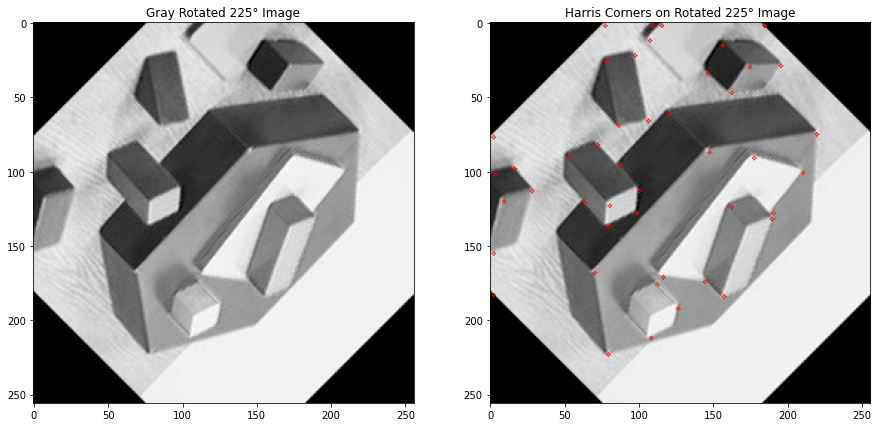

In [ ]:
# 225 Degree Rotation
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Rotate the image
gray_image = rotation(gray_image, 225)
rgb_image = rotation(rgb_image, 225)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray Rotated 225\u00B0 Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on Rotated 225\u00B0 Image')
print(f"Number of corner pixels detected: {count}")
print(rgb_image_copy.shape)

This is clearly rotationally invariant

In [ ]:
def scaling(image,f):
    scl_factor = f 
    w = int(image.shape[1] * scl_factor )
    h = int(image.shape[0] * scl_factor )
    dim = (w, h)
    rimg=resized = cv2.resize(image, dim, interpolation = cv2.INTER_CUBIC)
    return rimg

Number of corner pixels detected: 39
(128, 128, 3)


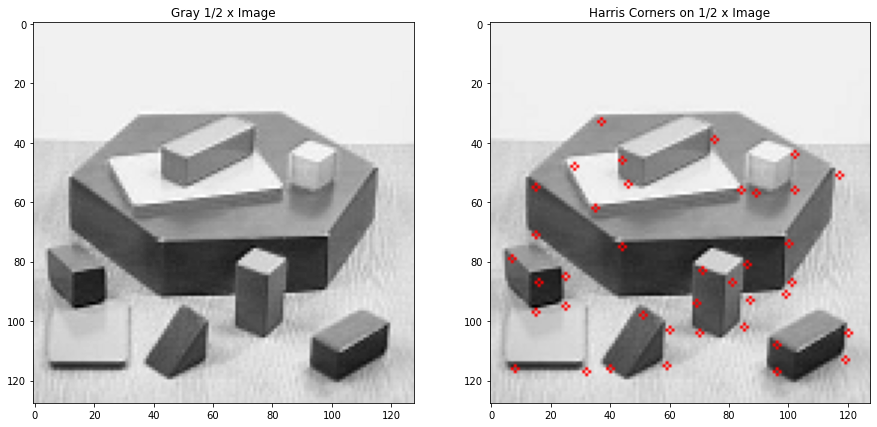

In [ ]:
# 1/2 x scaling
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Scale the image
gray_image = scaling(gray_image, 0.5)
rgb_image = scaling(rgb_image, 0.5)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray 1/2 x Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on 1/2 x Image')
print(f"Number of corner pixels detected: {count}")
print(rgb_image_copy.shape)

Number of corner pixels detected: 45
(192, 192, 3)


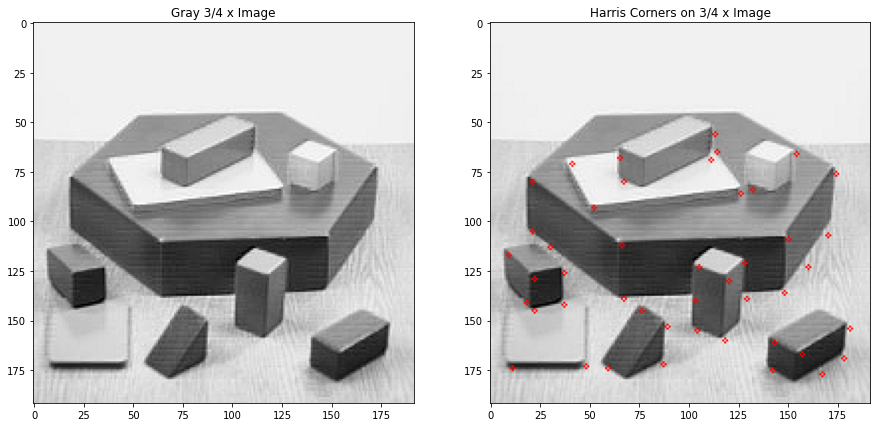

In [ ]:
# 3/4 x scaling
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Scale the image
gray_image = scaling(gray_image, 0.75)
rgb_image = scaling(rgb_image, 0.75)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray 3/4 x Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on 3/4 x Image')
print(f"Number of corner pixels detected: {count}")
print(rgb_image_copy.shape)

Number of corner pixels detected: 69
(384, 384, 3)


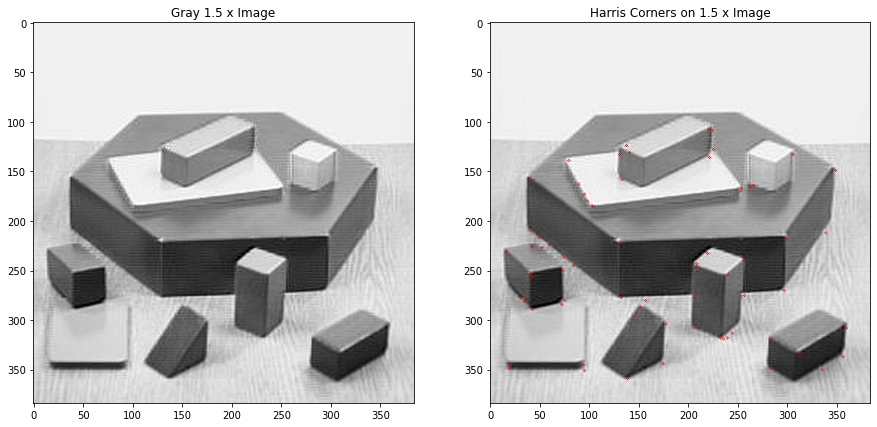

In [ ]:
# 1.5 x scaling
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Scale the image
gray_image = scaling(gray_image, 1.5)
rgb_image = scaling(rgb_image, 1.5)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray 1.5 x Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on 1.5 x Image')
print(f"Number of corner pixels detected: {count}")
print(rgb_image_copy.shape)

In [ ]:
import numpy as np
import cv2
import glob

# Kernel operation using input operator of size 3*3
def GetSobel(image, Sobel, width, height):
  # Initialize the matrix
  I_d = np.zeros((width, height), np.float32)

  # For every pixel in the image
  for rows in range(width):
      for cols in range(height):
          # Run the Sobel kernel for each pixel
          if rows >= 1 or rows <= width-2 and cols >= 1 or cols <= height-2:
              for ind in range(3):
                  for ite in range(3):
                      I_d[rows][cols] += Sobel[ind][ite] * image[rows - ind - 1][cols - ite - 1]
          else:
              I_d[rows][cols] = image[rows][cols]

  return I_d

# Method implements the Harris Corner Detection algorithm
def HarrisCornerDetection(image, k, Sigma, size, threshold):

  # The two Sobel operators - for x and y direction
  SobelX = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
  SobelY = SobelX.T

  w, h = image.shape

  # X and Y derivative of image using Sobel operator
  Ix = GetSobel(image, SobelX, w, h)
  Iy = GetSobel(image, SobelY, w, h)

  for ind1 in range(w):
      for ind2 in range(h):
          if Iy[ind1][ind2] < 0:
              Iy[ind1][ind2] *= -1
          if Ix[ind1][ind2] < 0:
              Ix[ind1][ind2] *= -1
              

  # # Display the output results after Sobel operations
  # print("\nIx:\n")
  # cv2_imshow(Ix)
  # print("\nIy:\n")
  # cv2_imshow(Iy)

  # Compute components of harris second moments matrix M
  '''
  M = | Ixx Ixy |
      | Iyx Iyy |
  '''
  Ixx = np.square(Ix)
  Iyy = np.square(Iy)

  Ixy = np.multiply(Ix, Iy)
  Iyx = np.multiply(Iy, Ix)

  # # Display the output second moments matrix components
  # print("\nIxx:\n")
  # cv2_imshow(Ixx)
  # print("\nIyy:\n")
  # cv2_imshow(Iyy)
  # print("\nIxy:\n")
  # cv2_imshow(Ixy)
  # print("\nIyx:\n")
  # cv2_imshow(Iyx)

  # Use Gaussian Blurring
  kernelsize = (size, size)

  Ixx = cv2.GaussianBlur(Ixx, kernelsize, Sigma)
  Iyy = cv2.GaussianBlur(Iyy, kernelsize, Sigma)
  Ixy = cv2.GaussianBlur(Ixy, kernelsize, Sigma)
  Iyx = cv2.GaussianBlur(Iyx, kernelsize, Sigma)
  # print(Ixy.shape, Iyx.shape)

  R = np.zeros((w, h), np.float32)
  # For every pixel find the corner strength
  # i.e. compute the harris response R
  for row in range(w):
    for col in range(h):
      '''
      M = | Ixx Ixy |
          | Iyx Iyy |
      '''
      M = np.array([[Ixx[row][col], Ixy[row][col]], [Iyx[row][col], Iyy[row][col]]])
      '''
      R = detM - k(traceM)^2
      '''
      R[row][col] = np.linalg.det(M) - (k * np.square(np.trace(M)))

  # Plot detected corners on image
  radius = 3
  color = (255, 0, 0)  # Red
  thickness = 1
  CornerStrengthThreshold = threshold
  
  count = 0
  PointList = []
  # Look for Corner strengths above the threshold
  for row in range(w):
    for col in range(h):
      if R[row][col] > CornerStrengthThreshold:
        # print(R[row][col])
        max = R[row][col]

        # Local non-maxima suppression
        skip = False
        for nrow in range(5):
          for ncol in range(5):
            if row + nrow - 2 < w and col + ncol - 2 < h:
              if R[row + nrow - 2][col + ncol - 2] > max:
                skip = True
                break

        if not skip:
          # Point is expressed in x, y which is col, row
          count+=1
          cv2.circle(rgb_image_copy, (col, row), radius, color, thickness)
          PointList.append((row, col))
  return rgb_image_copy, count

Number of corner pixels detected: 52
(512, 512, 3)


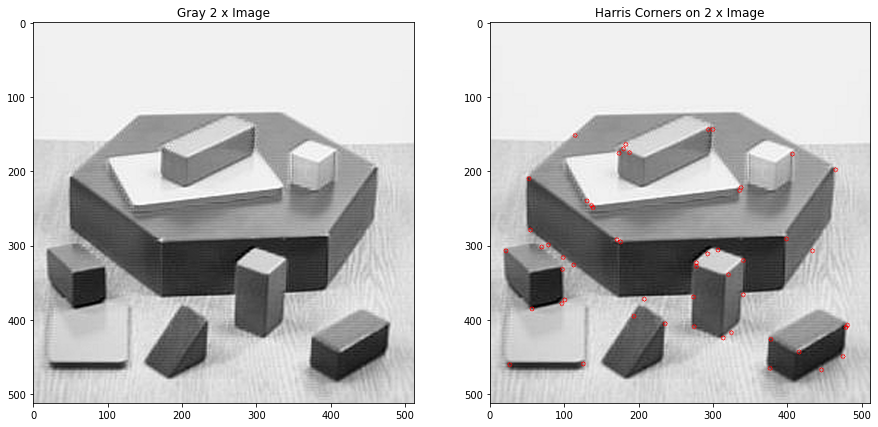

In [ ]:
# 2 x scaling
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Scale the image
gray_image = scaling(gray_image, 2)
rgb_image = scaling(rgb_image, 2)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray 2 x Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on 2 x Image')
print(f"Number of corner pixels detected: {count}")
print(rgb_image_copy.shape)

In [ ]:
import numpy as np
import cv2
import glob

# Kernel operation using input operator of size 3*3
def GetSobel(image, Sobel, width, height):
  # Initialize the matrix
  I_d = np.zeros((width, height), np.float32)

  # For every pixel in the image
  for rows in range(width):
      for cols in range(height):
          # Run the Sobel kernel for each pixel
          if rows >= 1 or rows <= width-2 and cols >= 1 or cols <= height-2:
              for ind in range(3):
                  for ite in range(3):
                      I_d[rows][cols] += Sobel[ind][ite] * image[rows - ind - 1][cols - ite - 1]
          else:
              I_d[rows][cols] = image[rows][cols]

  return I_d

# Method implements the Harris Corner Detection algorithm
def HarrisCornerDetection(image, k, Sigma, size, threshold):

  # The two Sobel operators - for x and y direction
  SobelX = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
  SobelY = SobelX.T

  w, h = image.shape

  # X and Y derivative of image using Sobel operator
  Ix = GetSobel(image, SobelX, w, h)
  Iy = GetSobel(image, SobelY, w, h)

  for ind1 in range(w):
      for ind2 in range(h):
          if Iy[ind1][ind2] < 0:
              Iy[ind1][ind2] *= -1
          if Ix[ind1][ind2] < 0:
              Ix[ind1][ind2] *= -1
              

  # # Display the output results after Sobel operations
  # print("\nIx:\n")
  # cv2_imshow(Ix)
  # print("\nIy:\n")
  # cv2_imshow(Iy)

  # Compute components of harris second moments matrix M
  '''
  M = | Ixx Ixy |
      | Iyx Iyy |
  '''
  Ixx = np.square(Ix)
  Iyy = np.square(Iy)

  Ixy = np.multiply(Ix, Iy)
  Iyx = np.multiply(Iy, Ix)

  # # Display the output second moments matrix components
  # print("\nIxx:\n")
  # cv2_imshow(Ixx)
  # print("\nIyy:\n")
  # cv2_imshow(Iyy)
  # print("\nIxy:\n")
  # cv2_imshow(Ixy)
  # print("\nIyx:\n")
  # cv2_imshow(Iyx)

  # Use Gaussian Blurring
  kernelsize = (size, size)

  Ixx = cv2.GaussianBlur(Ixx, kernelsize, Sigma)
  Iyy = cv2.GaussianBlur(Iyy, kernelsize, Sigma)
  Ixy = cv2.GaussianBlur(Ixy, kernelsize, Sigma)
  Iyx = cv2.GaussianBlur(Iyx, kernelsize, Sigma)
  # print(Ixy.shape, Iyx.shape)

  R = np.zeros((w, h), np.float32)
  # For every pixel find the corner strength
  # i.e. compute the harris response R
  for row in range(w):
    for col in range(h):
      '''
      M = | Ixx Ixy |
          | Iyx Iyy |
      '''
      M = np.array([[Ixx[row][col], Ixy[row][col]], [Iyx[row][col], Iyy[row][col]]])
      '''
      R = detM - k(traceM)^2
      '''
      R[row][col] = np.linalg.det(M) - (k * np.square(np.trace(M)))

  # Plot detected corners on image
  radius = 7
  color = (255, 0, 0)  # Red
  thickness = 1
  CornerStrengthThreshold = threshold
  
  count = 0
  PointList = []
  # Look for Corner strengths above the threshold
  for row in range(w):
    for col in range(h):
      if R[row][col] > CornerStrengthThreshold:
        # print(R[row][col])
        max = R[row][col]

        # Local non-maxima suppression
        skip = False
        for nrow in range(5):
          for ncol in range(5):
            if row + nrow - 2 < w and col + ncol - 2 < h:
              if R[row + nrow - 2][col + ncol - 2] > max:
                skip = True
                break

        if not skip:
          # Point is expressed in x, y which is col, row
          count+=1
          cv2.circle(rgb_image_copy, (col, row), radius, color, thickness)
          PointList.append((row, col))
  return rgb_image_copy, count

Number of corner pixels detected: 9
(768, 768, 3)


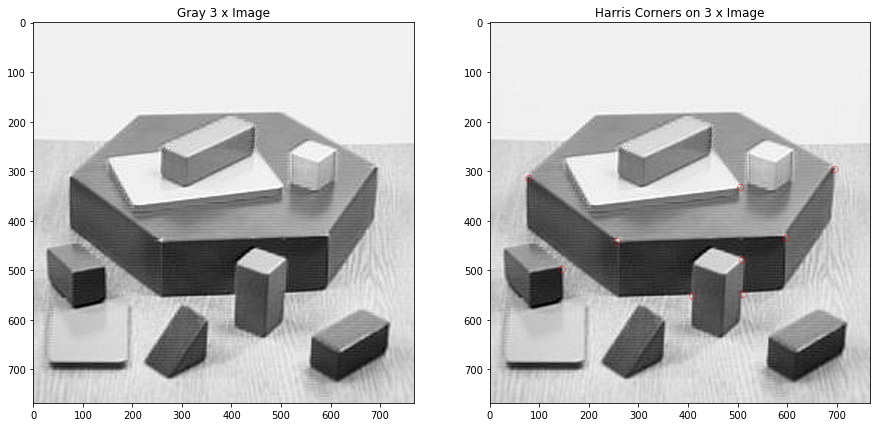

In [ ]:
# 3 x scaling
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Rotate the image
gray_image = scaling(gray_image, 3)
rgb_image = scaling(rgb_image, 3)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray 3 x Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on 3 x Image')
print(f"Number of corner pixels detected: {count}")
print(rgb_image_copy.shape)

Number of corner pixels detected: 22
(512, 512, 3)


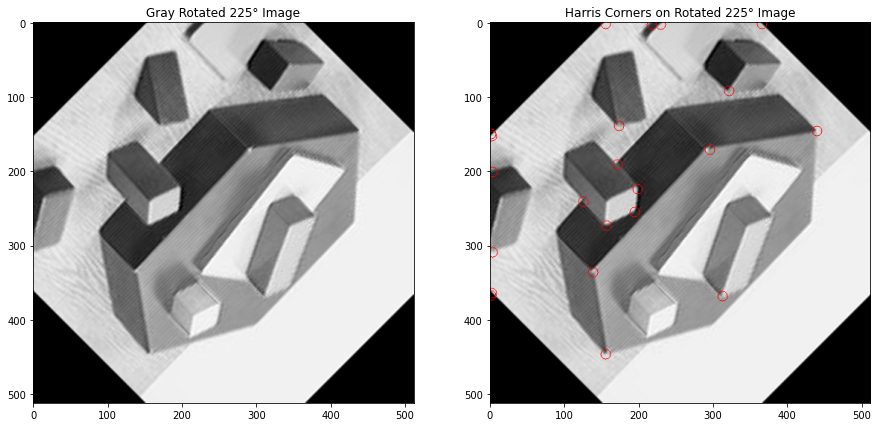

In [ ]:
# 225 Degree Rotation with 2x scaling
# Load the Image
rgb_image = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/Blocks_(test_image).pgm')
# Convert the image to grayscale
gray_image = cv2.cvtColor(rgb_image, cv2.COLOR_BGR2GRAY)

# Rotate the image
gray_image = rotation(gray_image, 225)
rgb_image = rotation(rgb_image, 225)

# Scale the image
gray_image = scaling(gray_image, 2)
rgb_image = scaling(rgb_image, 2)

# Get the first image dimensions
w, h = gray_image.shape

# Copy image to draw colored circles on it
rgb_image_copy = rgb_image.copy()

# Empirical Parameter
# These parameters will need tuning based on the use-case
threshold = 100000000
Sigma = 2
size = 3
k = 0.04

# Corner detection
rgb_image_copy, count = HarrisCornerDetection(gray_image, k, Sigma, size, threshold)

fig, axs = plt.subplots(1, 2)
fig.set_size_inches(15, 8)

axs[0].imshow(gray_image,cmap='gray')
axs[0].set_title('Gray Rotated 225\u00B0 Image')

axs[1].imshow(rgb_image_copy)
axs[1].set_title('Harris Corners on Rotated 225\u00B0 Image')
print(f"Number of corner pixels detected: {count}")
print(rgb_image_copy.shape)

## Part 2: 
1.	Use the provided code in Fig. 5 to detect the interest point (features) using the SIFT algorithm for the given Louisville Mosque data set.


In [2]:
# mount google drive to import test images
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# Load the Louisville Mosque data set

# import cv2 module for reading and displaying images from colab drive
from google.colab.patches import cv2, cv2_imshow

# Data Set 1
Louisville_Mosque_1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 1.jpg')
Louisville_Mosque_2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 2.jpg') 
Louisville_Mosque_3 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 3.jpg') 
Louisville_Mosque_4 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 4.jpg') 
Louisville_Mosque_5 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 5.jpg') 
Louisville_Mosque_6 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 6.jpg')
Louisville_Mosque_7 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 7.jpg')
Louisville_Mosque_9 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 9.jpg') 

# Data Set 2
Louisville_Mosque_10 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 10.jpg')
Louisville_Mosque_11 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 11.jpg') 
Louisville_Mosque_12 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 12.jpg') 
Louisville_Mosque_13 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 13.jpg') 

In [4]:
# create a list data structure of the images
image_list = []

# Data Set 1
image_list.append(Louisville_Mosque_1)
image_list.append(Louisville_Mosque_2)
image_list.append(Louisville_Mosque_3)
image_list.append(Louisville_Mosque_4)
image_list.append(Louisville_Mosque_5)
image_list.append(Louisville_Mosque_6)
image_list.append(Louisville_Mosque_7)
image_list.append(Louisville_Mosque_9)

# Data Set 2
image_list.append(Louisville_Mosque_10)
image_list.append(Louisville_Mosque_11)
image_list.append(Louisville_Mosque_12)
image_list.append(Louisville_Mosque_13)

In [5]:
import numpy as np
Louisville_Mosques = np.array(image_list)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  


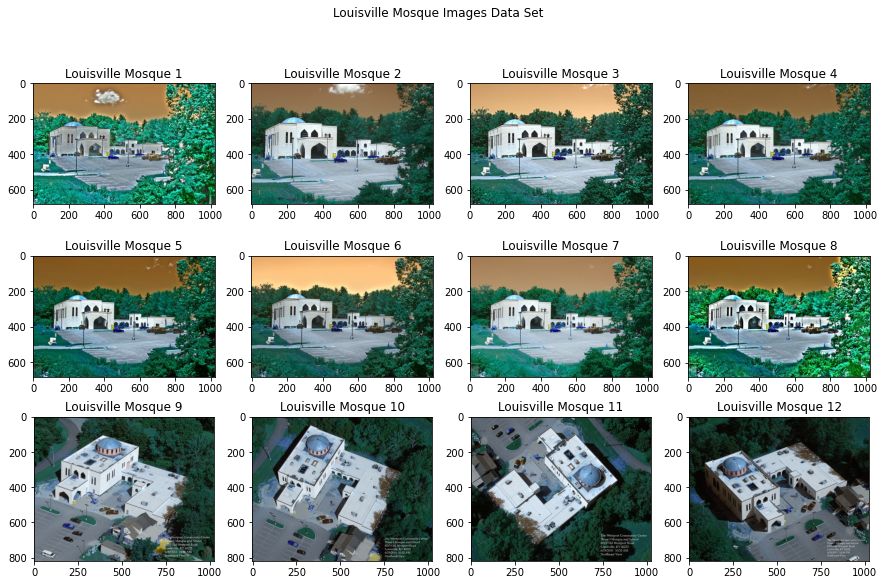

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

w=10
h=10
fig = plt.figure(figsize=(15, 9))
fig.set
columns = 4
rows = 3
for i in range(1, (columns * rows) + 1):
    img = Louisville_Mosques[i - 1]
    fig.add_subplot(rows, columns, i)
    plt.title(f"Louisville Mosque {i}")
    plt.imshow(img)
fig.suptitle('Louisville Mosque Images Data Set')
plt.show()

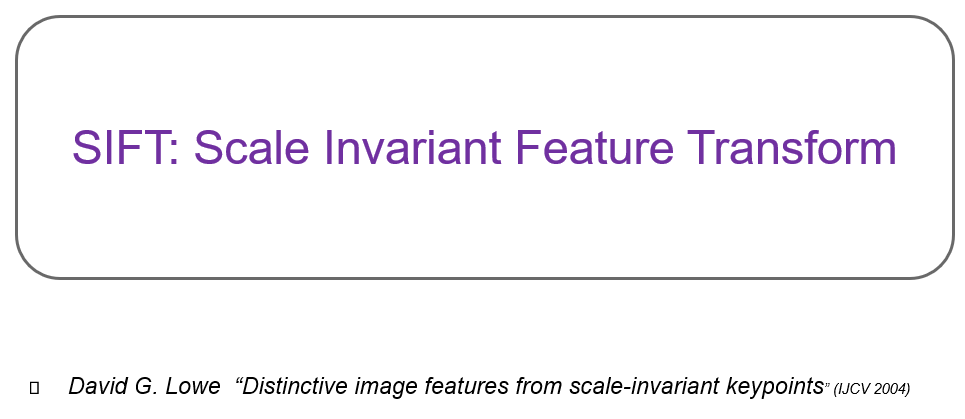

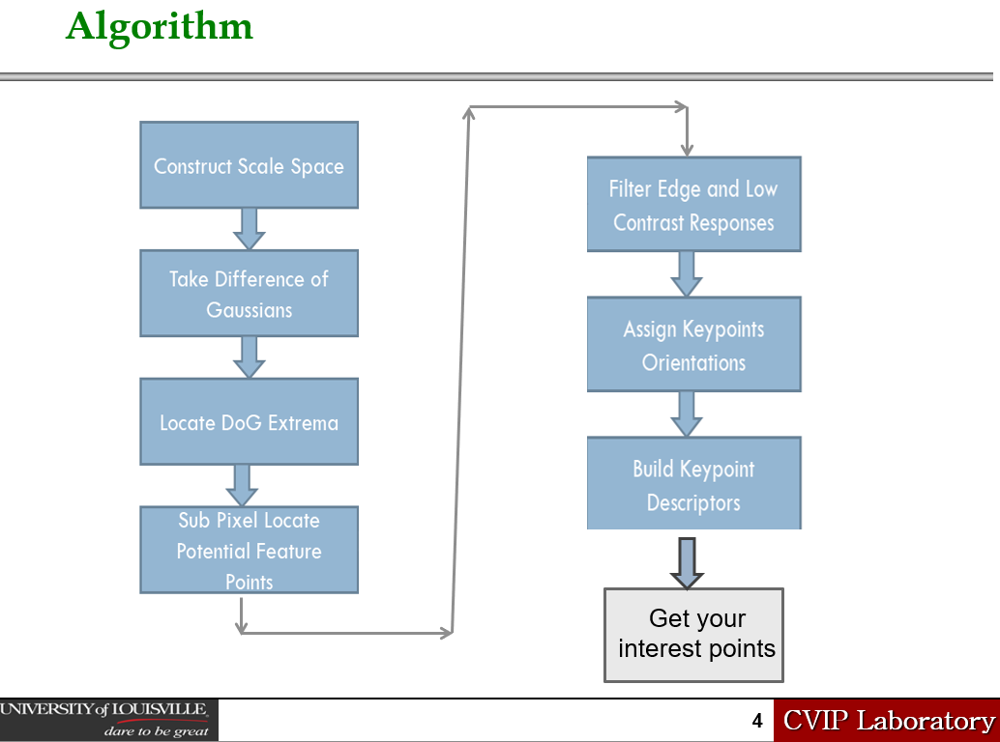


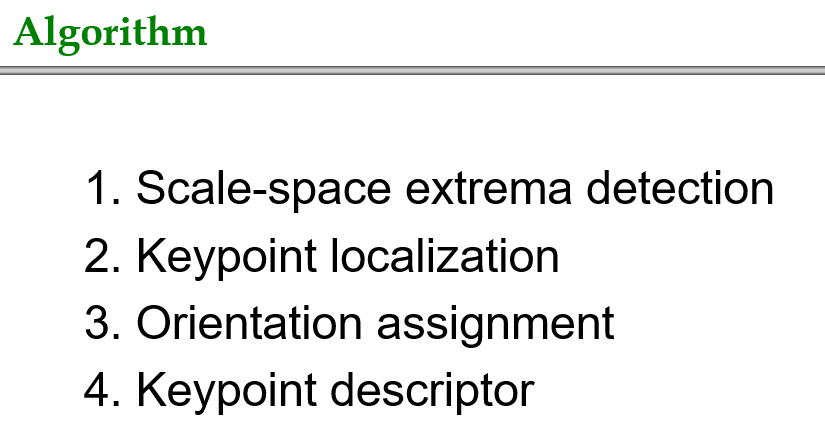

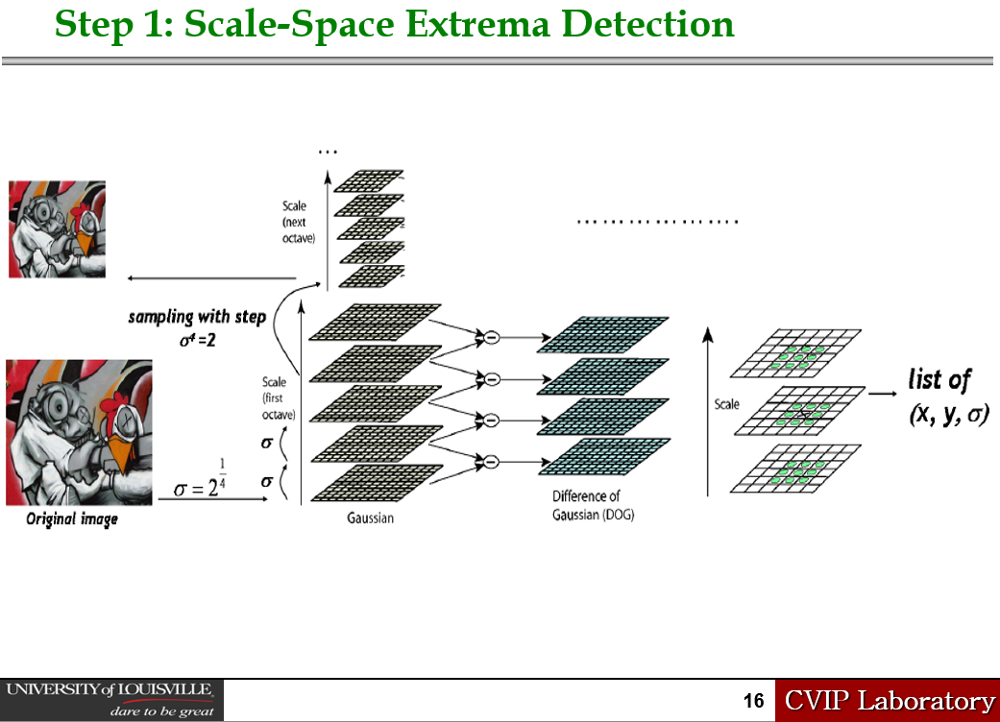

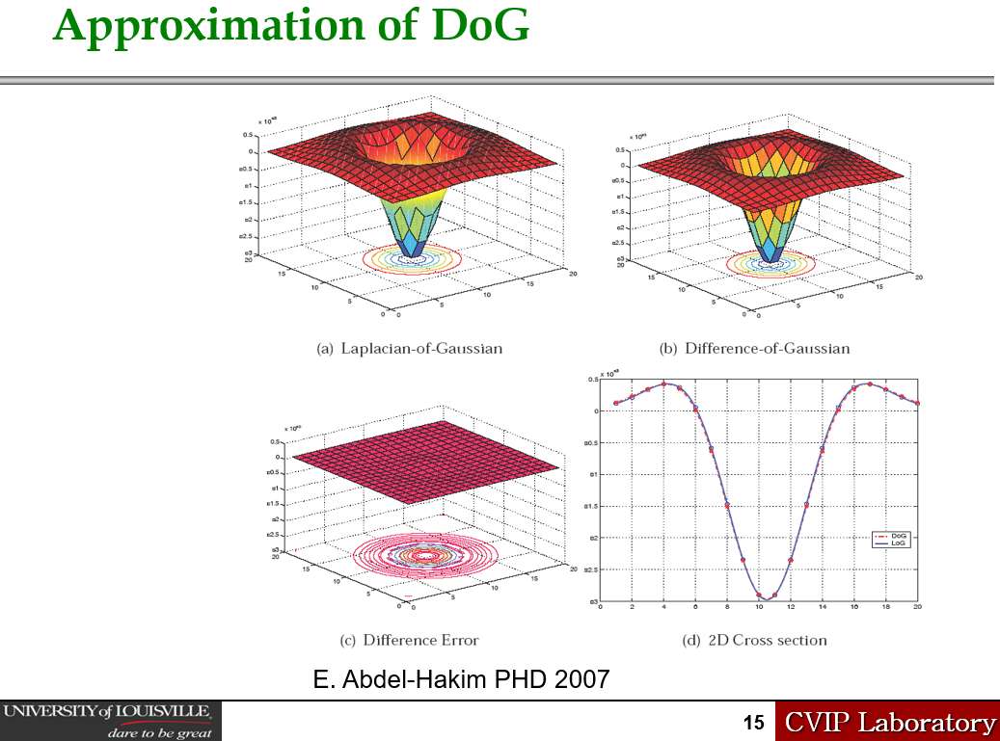

In [7]:
!pip install opencv-python==4.5.1.48

In [8]:
cv2.__version__

'4.5.1'

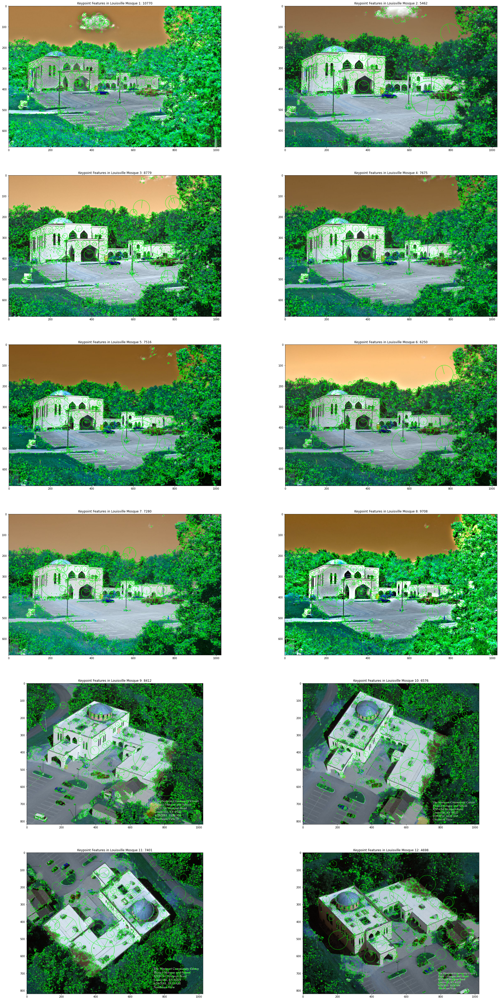

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt
import cv2

w=10
h=10
fig = plt.figure(figsize=(35, 70))
fig.set
columns = 2
rows = 6
number_of_keypoint_features = []
for i in range(1, (columns * rows) + 1):
  img = Louisville_Mosques[i - 1]
  gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

  # keypoints and descriptors
  sift = cv2.SIFT_create()
  kp, des = sift.detectAndCompute(gray_img, None)

  # store the number of keypoints in a list
  number_of_keypoint_features.append(kp)

  # Draw the keypoints
  kp_img = cv2.drawKeypoints(img, kp, None, color=(0, 255, 0),
                             flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

  fig.add_subplot(rows, columns, i)
  plt.title(f"Keypoint Features in Louisville Mosque {i}: {len(number_of_keypoint_features[i - 1])}")
  plt.imshow(kp_img)
plt.show()

In [9]:
!pip install pytictoc

In [9]:
# timing module similar to that in MATLAB
from pytictoc import TicToc
t = TicToc() #create instance of class

Elapsed time is 1.093014 seconds.
Elapsed time is 3.784299 seconds.


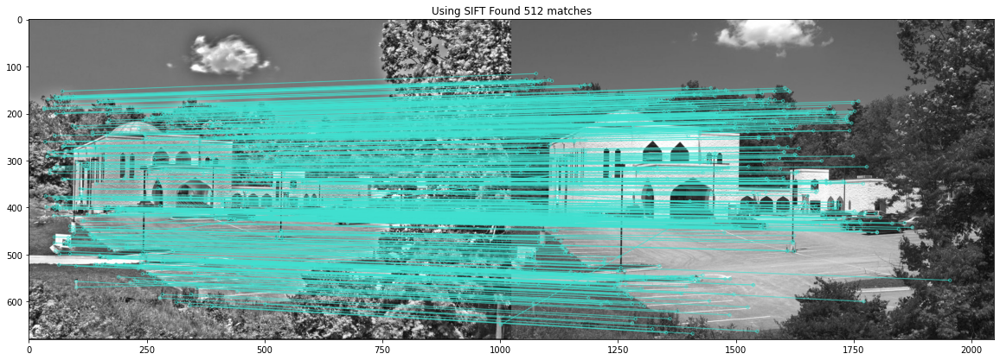

In [13]:
# Normal SIFT with detection timing and match timing for 1 and 2

import numpy as np
from google.colab.patches import cv2, cv2_imshow
from matplotlib import pyplot as plt

img1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 1.jpg') # queryImage
img2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 2.jpg') # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# use orb if sift is not installed
feature_extractor = cv2.SIFT_create()

# find the keypoints and descriptors with chosen feature_extractor
t.tic() # detection time
kp_1, desc_1 = feature_extractor.detectAndCompute(img1, None)
kp_2, desc_2 = feature_extractor.detectAndCompute(img2, None)
t.toc()

t.tic() # matching Time
# Brute Force Matching
matches = cv2.BFMatcher(cv2.NORM_L1).knnMatch(desc_1, desc_2, k=2)

# store all the good matches as per David Lowe's ratio test.
good = [[m] for m, n in matches if m.distance < 0.7*n.distance]

# show images
im_matches = cv2.drawMatchesKnn(img1, kp_1, img2, kp_2,
                                good, None,matchColor = (64, 224, 208), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
t.toc()
plt.figure(figsize=(20,10))
plt.title(f"Using SIFT Found {len(good)} matches")
plt.imshow(im_matches)
plt.show()

Elapsed time is 1.043534 seconds.
Elapsed time is 4.178837 seconds.


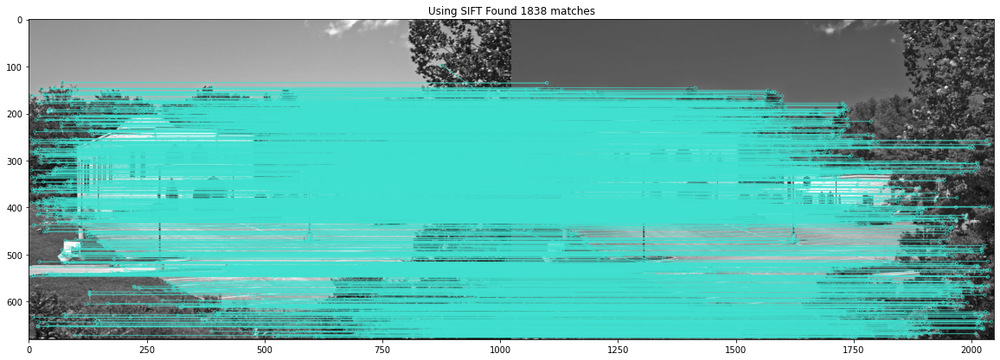

In [14]:
# Normal SIFT with detection timing and match timing for 3 and 4

import numpy as np
from google.colab.patches import cv2, cv2_imshow
from matplotlib import pyplot as plt

img1 = Louisville_Mosques[2] # queryImage
img2 = Louisville_Mosques[3] # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# use orb if sift is not installed
feature_extractor = cv2.SIFT_create()

# find the keypoints and descriptors with chosen feature_extractor
t.tic() # detection time
kp_1, desc_1 = feature_extractor.detectAndCompute(img1, None)
kp_2, desc_2 = feature_extractor.detectAndCompute(img2, None)
t.toc()

t.tic() # matching Time
# Brute Force Matching
matches = cv2.BFMatcher(cv2.NORM_L1).knnMatch(desc_1, desc_2, k=2)

# store all the good matches as per David Lowe's ratio test.
good = [[m] for m, n in matches if m.distance < 0.7*n.distance]

# show images
im_matches = cv2.drawMatchesKnn(img1, kp_1, img2, kp_2,
                                good, None,matchColor = (64, 224, 208), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
t.toc()
plt.figure(figsize=(20,10))
plt.title(f"Using SIFT Found {len(good)} matches")
plt.imshow(im_matches)
plt.show()

Elapsed time is 0.942934 seconds.
Elapsed time is 2.919465 seconds.


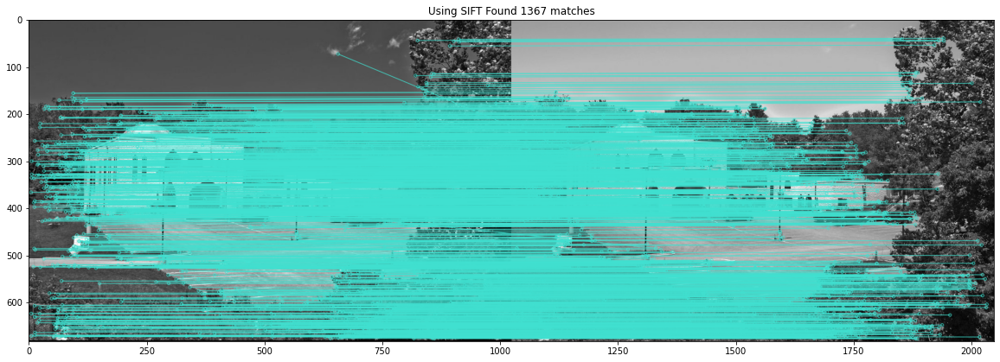

In [15]:
# Normal SIFT with detection timing and match timing for 5 and 6

import numpy as np
from google.colab.patches import cv2, cv2_imshow
from matplotlib import pyplot as plt

img1 = Louisville_Mosques[4] # queryImage
img2 = Louisville_Mosques[5] # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# use orb if sift is not installed
feature_extractor = cv2.SIFT_create()

# find the keypoints and descriptors with chosen feature_extractor
t.tic() # detection time
kp_1, desc_1 = feature_extractor.detectAndCompute(img1, None)
kp_2, desc_2 = feature_extractor.detectAndCompute(img2, None)
t.toc()

t.tic() # matching Time
# Brute Force Matching
matches = cv2.BFMatcher(cv2.NORM_L1).knnMatch(desc_1, desc_2, k=2)

# store all the good matches as per David Lowe's ratio test.
good = [[m] for m, n in matches if m.distance < 0.7*n.distance]

# show images
im_matches = cv2.drawMatchesKnn(img1, kp_1, img2, kp_2,
                                good, None,matchColor = (64, 224, 208), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
t.toc()
plt.figure(figsize=(20,10))
plt.title(f"Using SIFT Found {len(good)} matches")
plt.imshow(im_matches)
plt.show()

Elapsed time is 1.024387 seconds.
Elapsed time is 4.473762 seconds.


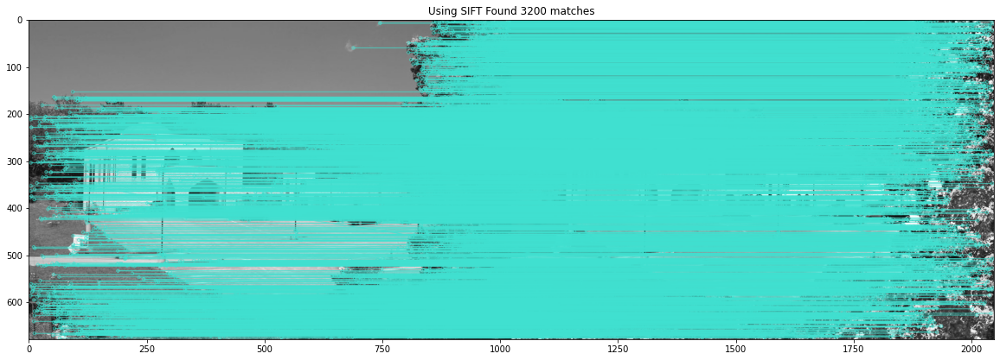

In [16]:
# Normal SIFT with detection timing and match timing for 7 and 8

import numpy as np
from google.colab.patches import cv2, cv2_imshow
from matplotlib import pyplot as plt

img1 = Louisville_Mosques[6] # queryImage
img2 = Louisville_Mosques[7] # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# use orb if sift is not installed
feature_extractor = cv2.SIFT_create()

# find the keypoints and descriptors with chosen feature_extractor
t.tic() # detection time
kp_1, desc_1 = feature_extractor.detectAndCompute(img1, None)
kp_2, desc_2 = feature_extractor.detectAndCompute(img2, None)
t.toc()

t.tic() # matching Time
# Brute Force Matching
matches = cv2.BFMatcher(cv2.NORM_L1).knnMatch(desc_1, desc_2, k=2)

# store all the good matches as per David Lowe's ratio test.
good = [[m] for m, n in matches if m.distance < 0.7*n.distance]

# show images
im_matches = cv2.drawMatchesKnn(img1, kp_1, img2, kp_2,
                                good, None,matchColor = (64, 224, 208), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
t.toc()
plt.figure(figsize=(20,10))
plt.title(f"Using SIFT Found {len(good)} matches")
plt.imshow(im_matches)
plt.show()

Elapsed time is 1.041300 seconds.
Elapsed time is 3.412406 seconds.


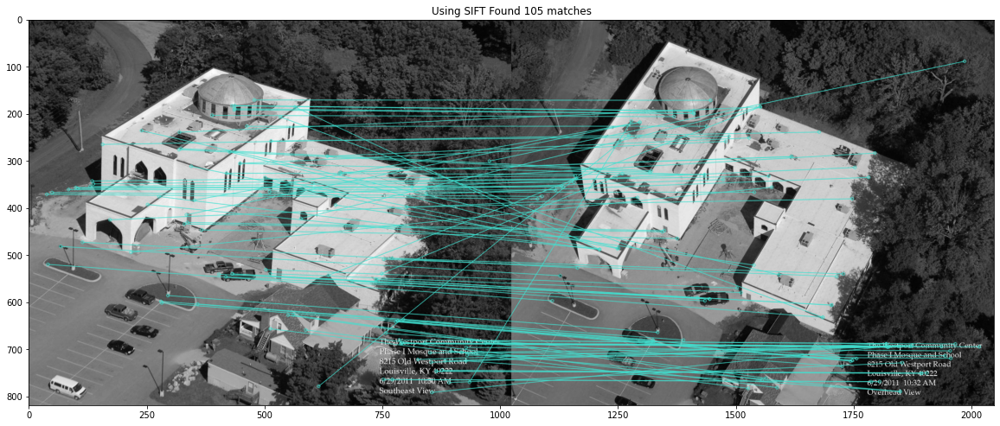

In [17]:
# Normal SIFT with detection timing and match timing for 9 and 10

import numpy as np
from google.colab.patches import cv2, cv2_imshow
from matplotlib import pyplot as plt

img1 = Louisville_Mosques[8] # queryImage
img2 = Louisville_Mosques[9] # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# use orb if sift is not installed
feature_extractor = cv2.SIFT_create()

# find the keypoints and descriptors with chosen feature_extractor
t.tic() # detection time
kp_1, desc_1 = feature_extractor.detectAndCompute(img1, None)
kp_2, desc_2 = feature_extractor.detectAndCompute(img2, None)
t.toc()

t.tic() # matching Time
# Brute Force Matching
matches = cv2.BFMatcher(cv2.NORM_L1).knnMatch(desc_1, desc_2, k=2)

# store all the good matches as per David Lowe's ratio test.
good = [[m] for m, n in matches if m.distance < 0.7*n.distance]

# show images
im_matches = cv2.drawMatchesKnn(img1, kp_1, img2, kp_2,
                                good, None,matchColor = (64, 224, 208), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
t.toc()
plt.figure(figsize=(20,10))
plt.title(f"Using SIFT Found {len(good)} matches")
plt.imshow(im_matches)
plt.show()

Elapsed time is 0.960667 seconds.
Elapsed time is 2.224353 seconds.


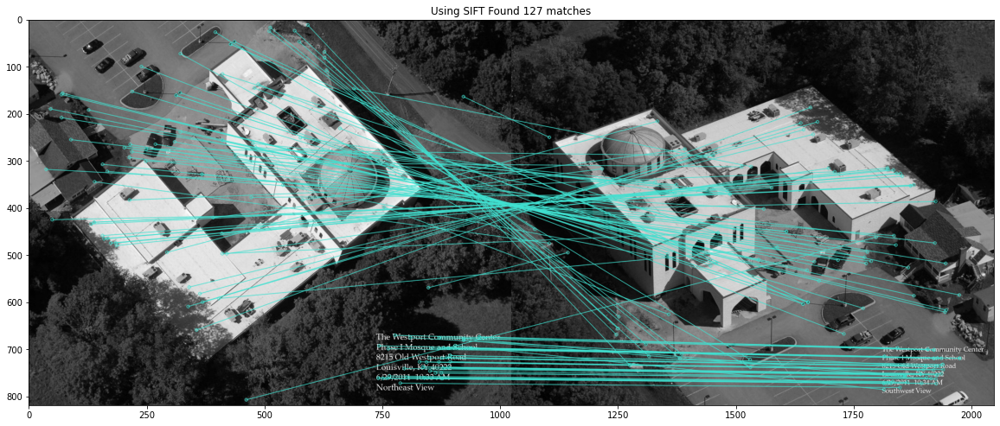

In [18]:
# Normal SIFT with detection timing and match timing for 11 and 12

import numpy as np
from google.colab.patches import cv2, cv2_imshow
from matplotlib import pyplot as plt

img1 = Louisville_Mosques[10] # queryImage
img2 = Louisville_Mosques[11] # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# use orb if sift is not installed
feature_extractor = cv2.SIFT_create()

# find the keypoints and descriptors with chosen feature_extractor
t.tic() # detection time
kp_1, desc_1 = feature_extractor.detectAndCompute(img1, None)
kp_2, desc_2 = feature_extractor.detectAndCompute(img2, None)
t.toc()

t.tic() # matching Time
# Brute Force Matching
matches = cv2.BFMatcher(cv2.NORM_L1).knnMatch(desc_1, desc_2, k=2)

# store all the good matches as per David Lowe's ratio test.
good = [[m] for m, n in matches if m.distance < 0.7*n.distance]

# show images
im_matches = cv2.drawMatchesKnn(img1, kp_1, img2, kp_2,
                                good, None,matchColor = (64, 224, 208), flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
t.toc()
plt.figure(figsize=(20,10))
plt.title(f"Using SIFT Found {len(good)} matches")
plt.imshow(im_matches)
plt.show()

Elapsed time is 1.049232 seconds.
Elapsed time is 3.840096 seconds.


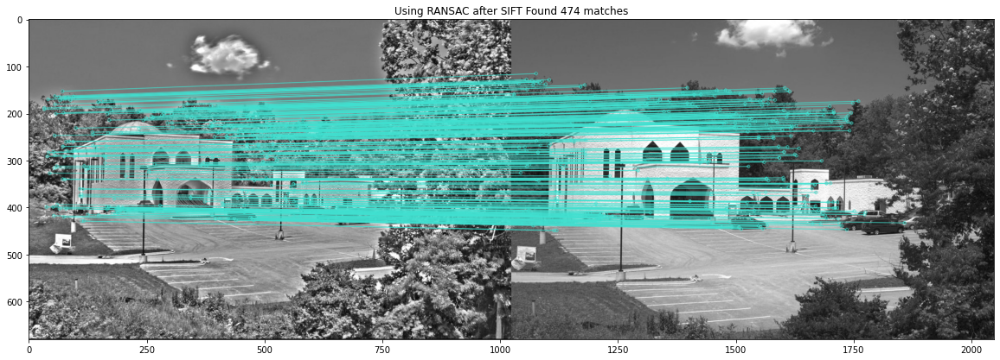

In [10]:
# SIFT with RANSAC and detection timing and match timing for images 1 and 2
# RANSAC to reject the false match (the outliers)

import numpy as np
import cv2
from matplotlib import pyplot as plt

MIN_MATCH_COUNT = 10

img1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 1.jpg') # queryImage
img2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 2.jpg') # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
t.tic() # detection time
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)
t.toc()

t.tic() # matching Time
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2)

# store all the good matches as per David Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

# match good source points with destination points 
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    inliers, matchedcount = np.sum(mask), len(mask)
    matchesMask = mask.ravel().tolist()

    h,w = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,M)

    img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

else:
    print(f"Not enough matches are found - {len(good)},{MIN_MATCH_COUNT}")
    matchesMask = None

draw_params = dict(matchColor = (64, 224, 208), # draw matches in teal color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)
t.toc()

plt.figure(figsize=(20,10))
plt.title(f"Using RANSAC after SIFT Found {len(good)} matches")
plt.imshow(img3, 'gray')
plt.show()

Elapsed time is 1.002193 seconds.
Elapsed time is 4.472710 seconds.


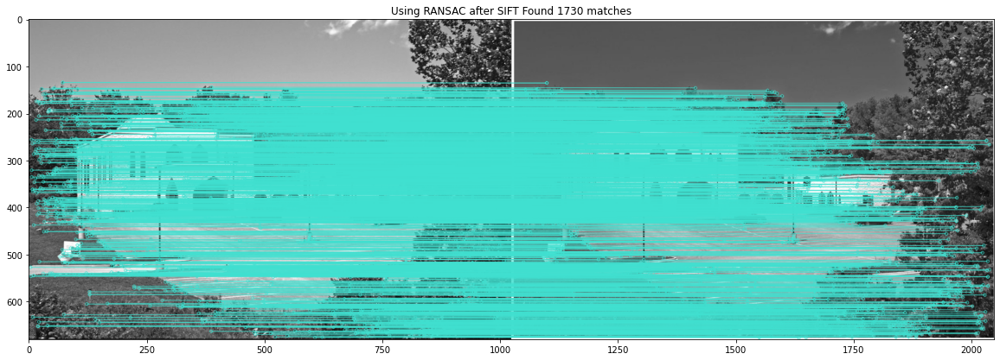

In [11]:
# SIFT with RANSAC and detection timing and match timing for images 3 and 4
# RANSAC to reject the false match (the outliers)

import numpy as np
import cv2
from matplotlib import pyplot as plt

MIN_MATCH_COUNT = 10

img1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 3.jpg') # queryImage
img2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 4.jpg') # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
t.tic() # detection time
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)
t.toc()

t.tic() # matching Time
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2)

# store all the good matches as per David Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

# match good source points with destination points 
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    inliers, matchedcount = np.sum(mask), len(mask)
    matchesMask = mask.ravel().tolist()

    h,w = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,M)

    img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

else:
    print(f"Not enough matches are found - {len(good)},{MIN_MATCH_COUNT}")
    matchesMask = None

draw_params = dict(matchColor = (64, 224, 208), # draw matches in teal color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)
t.toc()

plt.figure(figsize=(20,10))
plt.title(f"Using RANSAC after SIFT Found {len(good)} matches")
plt.imshow(img3, 'gray')
plt.show()

Elapsed time is 0.923674 seconds.
Elapsed time is 3.126101 seconds.


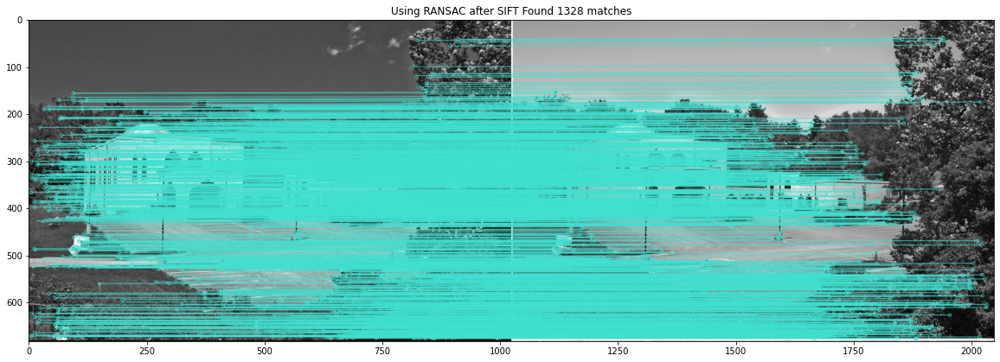

In [12]:
# SIFT with RANSAC and detection timing and match timing for images 5 and 6
# RANSAC to reject the false match (the outliers)

import numpy as np
import cv2
from matplotlib import pyplot as plt

MIN_MATCH_COUNT = 10

img1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 5.jpg') # queryImage
img2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 6.jpg') # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
t.tic() # detection time
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)
t.toc()

t.tic() # matching Time
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2)

# store all the good matches as per David Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

# match good source points with destination points 
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    inliers, matchedcount = np.sum(mask), len(mask)
    matchesMask = mask.ravel().tolist()

    h,w = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,M)

    img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

else:
    print(f"Not enough matches are found - {len(good)},{MIN_MATCH_COUNT}")
    matchesMask = None

draw_params = dict(matchColor = (64, 224, 208), # draw matches in teal color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)
t.toc()

plt.figure(figsize=(20,10))
plt.title(f"Using RANSAC after SIFT Found {len(good)} matches")
plt.imshow(img3, 'gray')
plt.show()

Elapsed time is 1.071857 seconds.
Elapsed time is 4.818924 seconds.


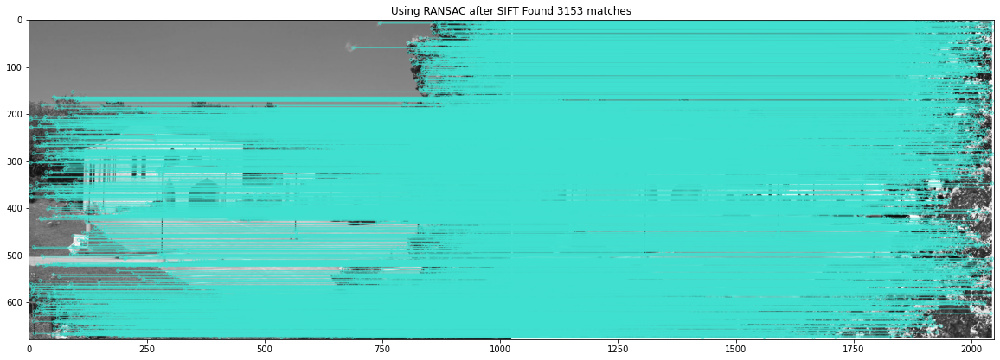

In [3]:
# SIFT with RANSAC and detection timing and match timing for images 7 and 8 (8 is actually 9)
# RANSAC to reject the false match (the outliers)

# timing module similar to that in MATLAB
from pytictoc import TicToc
t = TicToc() #create instance of class

import numpy as np
import cv2
from matplotlib import pyplot as plt

MIN_MATCH_COUNT = 10

img1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 7.jpg') # queryImage
img2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 1/Louisville Mosque 9.jpg') # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
t.tic() # detection time
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)
t.toc()

t.tic() # matching Time
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2)

# store all the good matches as per David Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

# match good source points with destination points 
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    inliers, matchedcount = np.sum(mask), len(mask)
    matchesMask = mask.ravel().tolist()

    h,w = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,M)

    img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

else:
    print(f"Not enough matches are found - {len(good)},{MIN_MATCH_COUNT}")
    matchesMask = None

draw_params = dict(matchColor = (64, 224, 208), # draw matches in teal color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)
t.toc()

plt.figure(figsize=(20,10))
plt.title(f"Using RANSAC after SIFT Found {len(good)} matches")
plt.imshow(img3, 'gray')
plt.show()

Elapsed time is 1.053568 seconds.
Elapsed time is 3.668041 seconds.


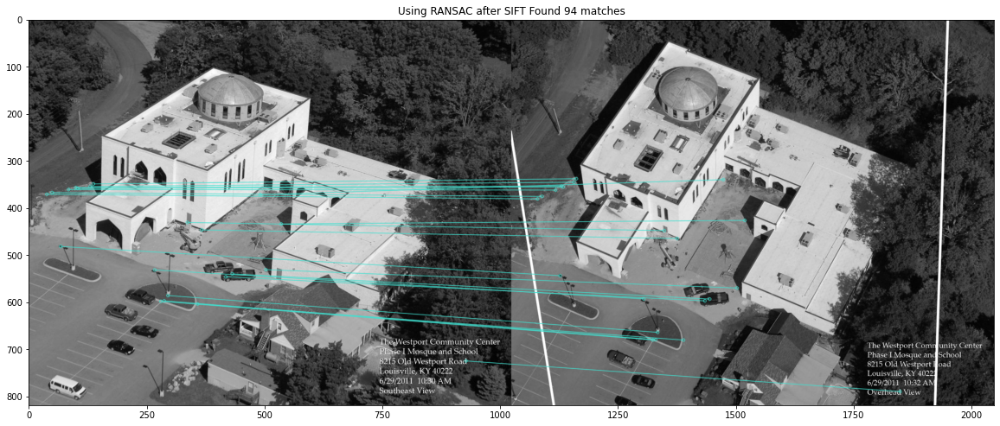

In [4]:
# SIFT with RANSAC and detection timing and match timing for images 9 and 10
# RANSAC to reject the false match (the outliers)

# timing module similar to that in MATLAB
from pytictoc import TicToc
t = TicToc() #create instance of class

import numpy as np
import cv2
from matplotlib import pyplot as plt

MIN_MATCH_COUNT = 10

img1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 10.jpg') # queryImage
img2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 11.jpg') # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
t.tic() # detection time
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)
t.toc()

t.tic() # matching Time
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2)

# store all the good matches as per David Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

# match good source points with destination points 
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    inliers, matchedcount = np.sum(mask), len(mask)
    matchesMask = mask.ravel().tolist()

    h,w = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,M)

    img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

else:
    print(f"Not enough matches are found - {len(good)},{MIN_MATCH_COUNT}")
    matchesMask = None

draw_params = dict(matchColor = (64, 224, 208), # draw matches in teal color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)
t.toc()

plt.figure(figsize=(20,10))
plt.title(f"Using RANSAC after SIFT Found {len(good)} matches")
plt.imshow(img3, 'gray')
plt.show()

Elapsed time is 0.947795 seconds.
Elapsed time is 2.322261 seconds.


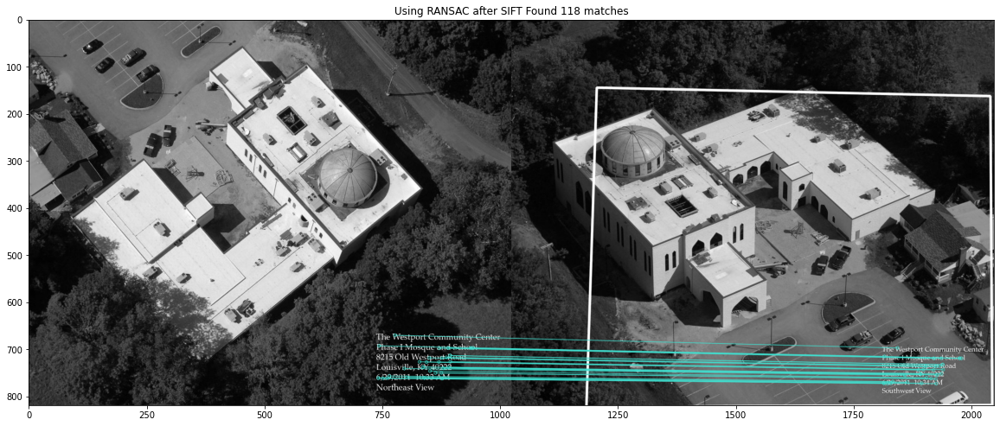

In [5]:
# SIFT with RANSAC and detection timing and match timing for images 11 and 12
# RANSAC to reject the false match (the outliers)

# timing module similar to that in MATLAB
from pytictoc import TicToc
t = TicToc() #create instance of class

import numpy as np
import cv2
from matplotlib import pyplot as plt

MIN_MATCH_COUNT = 10

img1 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 12.jpg') # queryImage
img2 = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Feature Extraction/data set 2/Louisville Mosque 13.jpg') # trainImage

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
t.tic() # detection time
kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)
t.toc()

t.tic() # matching Time
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2)

# store all the good matches as per David Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

# match good source points with destination points 
if len(good)>MIN_MATCH_COUNT:
    src_pts = np.float32([ kp1[m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp2[m.trainIdx].pt for m in good ]).reshape(-1,1,2)

    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    inliers, matchedcount = np.sum(mask), len(mask)
    matchesMask = mask.ravel().tolist()

    h,w = img1.shape
    pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
    dst = cv2.perspectiveTransform(pts,M)

    img2 = cv2.polylines(img2,[np.int32(dst)],True,255,3, cv2.LINE_AA)

else:
    print(f"Not enough matches are found - {len(good)},{MIN_MATCH_COUNT}")
    matchesMask = None

draw_params = dict(matchColor = (64, 224, 208), # draw matches in teal color
                   singlePointColor = None,
                   matchesMask = matchesMask, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)
t.toc()

plt.figure(figsize=(20,10))
plt.title(f"Using RANSAC after SIFT Found {len(good)} matches")
plt.imshow(img3, 'gray')
plt.show()

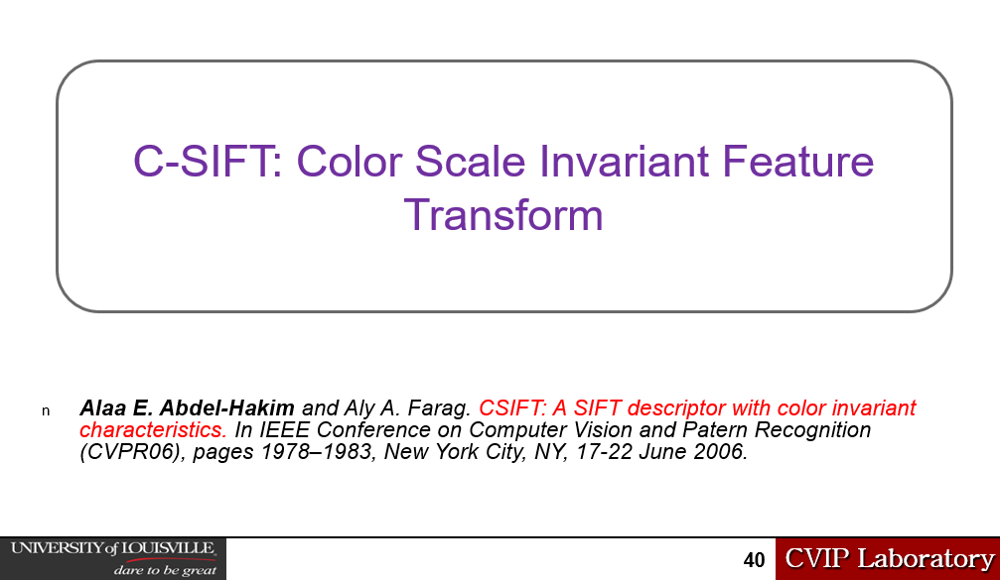

In [6]:
# mount google drive to import test images
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


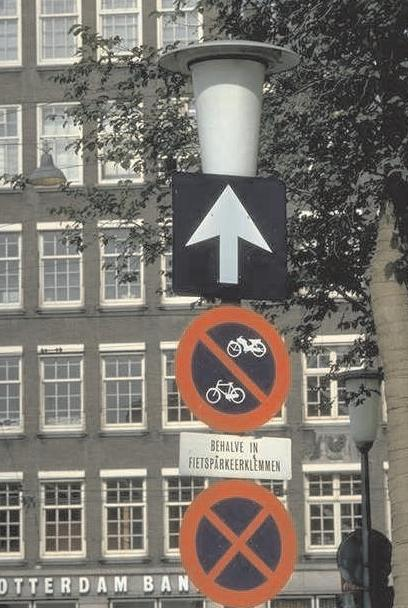

(608, 408, 3)


In [9]:
# import cv2 module for reading and displaying images from colab drive
from google.colab.patches import cv2, cv2_imshow

img1 = cv2.imread("/content/drive/MyDrive/Colab Notebooks/Feature Extraction/abn.ppm")

cv2_imshow(img1)
print(img1.shape)

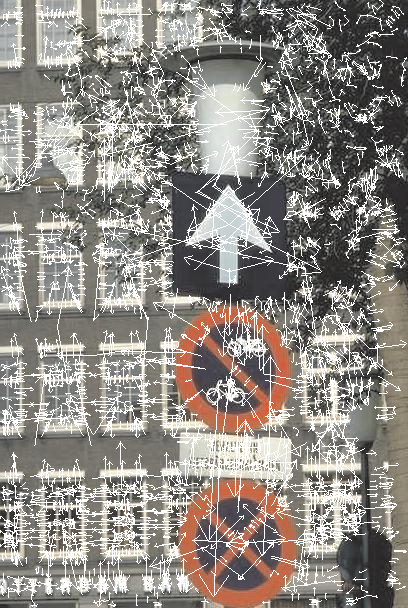

(608, 408, 3)


In [10]:
# import cv2 module for reading and displaying images from colab drive
from google.colab.patches import cv2, cv2_imshow

img2 = cv2.imread("/content/drive/MyDrive/Colab Notebooks/Feature Extraction/resabncol.ppm")

cv2_imshow(img2)
print(img2.shape)

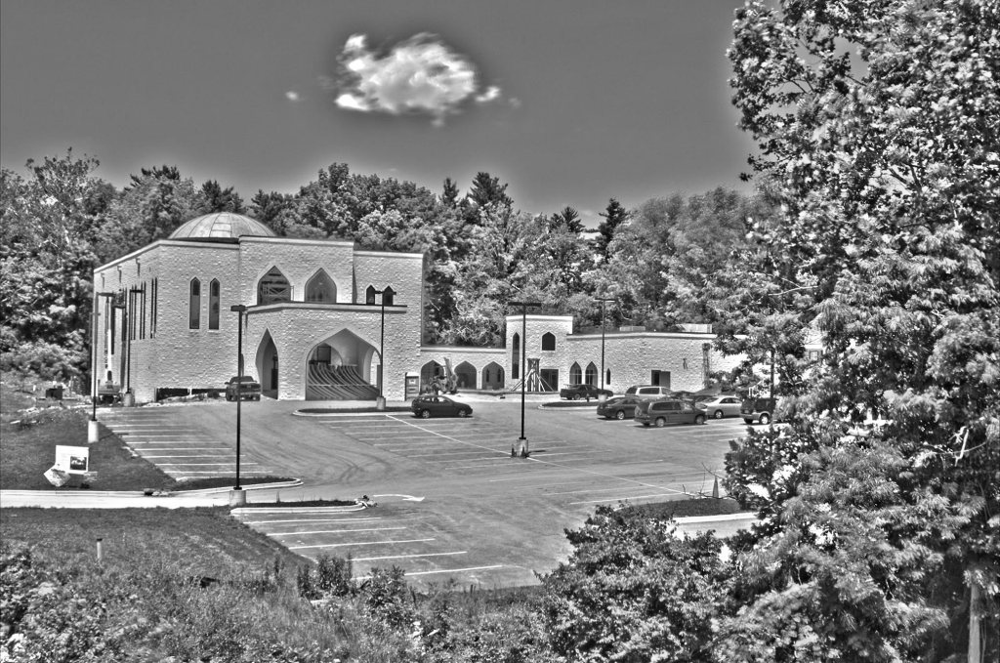

(679, 1024, 3)


In [12]:
# import cv2 module for reading and displaying images from colab drive
from google.colab.patches import cv2, cv2_imshow

img2 = cv2.imread("/content/drive/MyDrive/Colab Notebooks/Feature Extraction/tmp.pgm")

cv2_imshow(img2)
print(img2.shape)